In [1]:
import pandas as pd
import logging
import requests
import copy
import math
import time
import nltk
from elasticsearch import helpers

from elasticsearch import Elasticsearch


In [2]:
file_name = '/home/melquicarvalho/Documentos/tcctest/relv_test.csv'

# Carregando df_unique
data_frame após exclusão de descrições duplicates


In [2]:
df_nf_unique = pd.read_csv('notasFiscais/df_nf_unique.csv')
df_nf_unique

/tmp/ipykernel_5679/1538487853.py:1: DtypeWarning: Columns (20) have mixed types. Specify dtype option on import or set low_memory=False.
  df_nf_unique = pd.read_csv('notasFiscais/df_nf_unique.csv')


,ID,MODELO,SERIE,NUMERO_NOTA_FISCAL,DATA_EMISSAO,CNPJ_CPF_EMITENTE,RAZAO_SOCIAL_EMITENTE,NOME_FANTASIA_EMITENTE,TIPO_DESTINATARIO,CNPJ_CPF_DESTINATARIO,...,DESCRICAO_PRODUTO,UNIDADE_PRODUTO,UNIDADE_PRODUTO_TRIBUTAVEL,QUANTIDADE_PRODUTO,QUANTIDADE_PRODUTO_TRIBUTAVEL,VALOR_PRODUTO,VALOR_PRODUTO_TRIBUTAVEL,CODIGO_BARRA,CODIGO_BARRA_TRIBUTAVEL,NCM
0,10,55,21,37005,2022-01-01 00:00:00.000,56228356013381,CRBS S/A - CDC Rio Branco,CDC RIO BRANCO,PESSOA_JURIDICA,NaN,...,"SKOL 600ML 6,...",Un,Un,2.0,2.0,5.69,5.69,7891149200405,7891149200405,22030000
1,14,55,21,37005,2022-01-01 00:00:00.000,56228356013381,CRBS S/A - CDC Rio Branco,CDC RIO BRANCO,PESSOA_JURIDICA,NaN,...,"ANTARCTICA PILSEN LATA 350ML SH C/12 NPAL 10,...",Un,Un,12.0,12.0,10.22,10.22,7891991002141,7891991000796,22030000
2,16,55,21,37005,2022-01-01 00:00:00.000,56228356013381,CRBS S/A - CDC Rio Branco,CDC RIO BRANCO,PESSOA_JURIDICA,NaN,...,"PEPSI COLA PET 2L CAIXA C/6 9,...",Un,Un,1.0,1.0,9.61,9.61,7892840800246,7892840800000,22021000
3,53,55,1,2148830,2022-01-01 00:00:00.000,3007331001032,EBAZAR.COM.BR. LTDA,NaN,PESSOA_FISICA,NaN,...,Potes Hermeticos Porta-Mantimentos Tampa Bambu...,UN,UN,1.0,1.0,139.90,139.90,7909569365786,7909569365786,70134290
4,88,55,1,25085,2022-01-01 00:00:00.000,21393527000101,RECOL FARMA LTDA.,RECOL FARMA - 24HORAS,PESSOA_JURIDICA,NaN,...,GRIPINEW C/20 CPR,UN1,UN1,1.0,1.0,8.99,8.99,7896862920029,7896862920029,30045090
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2248616,75679419,55,10,12741,2023-07-31 00:00:00.000,5915706000105,COMERCIAL JAPIIM LTDA,COMERCIAL JAPIIM,PESSOA_JURIDICA,NaN,...,ROSQUINHA CHOCOLATE ZERO LOW 150G,UN1,UN1,1.0,1.0,8.07,8.07,7896292070080,7896292070080,19053100
2248617,75679436,55,10,12741,2023-07-31 00:00:00.000,5915706000105,COMERCIAL JAPIIM LTDA,COMERCIAL JAPIIM,PESSOA_JURIDICA,NaN,...,BISC HOT CRACK QUEIJO 150G,UN1,UN1,8.0,8.0,6.26,6.26,7896011105499,7896011105499,19053100
2248618,75679441,55,10,12741,2023-07-31 00:00:00.000,5915706000105,COMERCIAL JAPIIM LTDA,COMERCIAL JAPIIM,PESSOA_JURIDICA,NaN,...,MACARRAO NINHO LARGO PARATI 500G,UN1,UN1,1.0,1.0,5.25,5.25,7896011107028,7896011107028,19021100
2248619,75679480,55,10,12742,2023-07-31 00:00:00.000,5915706000105,COMERCIAL JAPIIM LTDA,COMERCIAL JAPIIM,PESSOA_JURIDICA,NaN,...,GRAFITE ESTAMPADAS,UN1,UN1,1.0,1.0,1.00,1.00,6944504411457,6944504411457,96084000


Selecionando apenas codigos de barra que se repetem ao menos 5 vezes no df_unique


In [8]:
codigo_barra_relv = dv_relev_sample['CODIGO_BARRA'].tolist()
codigo_barra_relv

[7898062608721,
 7896380173433,
 7891000261026,
 7891260382752,
 7891117007128,
 7896040704625,
 7891435051834,
 7898133136450,
 7897801300841,
 7897801301763,
 7891040113491,
 7896079587329,
 7500435157513,
 7895500761178,
 7891033716418,
 7898526969856,
 7898932213895,
 7898610372555,
 7891019170609,
 7898075640053,
 7908324400298,
 7891242161818,
 7896011102610,
 7899381693962,
 7891521359127,
 7893371000259,
 7891117003748,
 7899952304273,
 7891033773572,
 7891321333174,
 7500435169370,
 7891317439002,
 7898436366844,
 7894325109585,
 7896112401926,
 7891150036390,
 4005808335435,
 7896004720838,
 7804540226387,
 7898330152109,
 7891696009551,
 4013790009432,
 7898360914173,
 7891150071537,
 7891117003922,
 7908324400120,
 7899065804998,
 789109550004,
 7897016830133,
 7891035800245]

In [11]:
df_nf_codg_relv = df_nf_unique[df_nf_unique['CODIGO_BARRA'].isin(codigo_barra_relv)]
df_nf_codg_relv

,ID,MODELO,SERIE,NUMERO_NOTA_FISCAL,DATA_EMISSAO,CNPJ_CPF_EMITENTE,RAZAO_SOCIAL_EMITENTE,NOME_FANTASIA_EMITENTE,TIPO_DESTINATARIO,CNPJ_CPF_DESTINATARIO,...,DESCRICAO_PRODUTO,UNIDADE_PRODUTO,UNIDADE_PRODUTO_TRIBUTAVEL,QUANTIDADE_PRODUTO,QUANTIDADE_PRODUTO_TRIBUTAVEL,VALOR_PRODUTO,VALOR_PRODUTO_TRIBUTAVEL,CODIGO_BARRA,CODIGO_BARRA_TRIBUTAVEL,NCM
758,21152,55,1,115652,2022-01-02 00:00:00.000,84308980000184,A.C.D.A. IMPORTACAO E EXPORTACAO LTDA,ARASUPER BOSQUE,PESSOA_FISICA,NaN,...,IOG POLPA NINHO 540G,UN1,UN1,1.0,1.0,6.69,6.69,7891000261026,7891000261026,4031000
1445,35412,55,2,6658,2022-01-03 00:00:00.000,4119970001214,AGRO BOI IMPORTACAO E EXPORTACAO LTDA,AGROBOI CORES,PESSOA_JURIDICA,NaN,...,"ACRILICO TOQUE DE LUZ 3,2L BASE C2",UN,UN,1.0,1.0,140.00,140.00,7891260382752,7891260382752,32091010
3612,72951,55,1,23493,2022-01-03 00:00:00.000,4521258001590,J CRUZ LTDA-HOJE,HOJE COSMETICS 15-90,PESSOA_JURIDICA,NaN,...,KIT PANTENE HIDRATACAO SH350ML+COND175ML,UN,UN,12.0,12.0,21.37,21.37,7500435169370,7500435169370,33051000
5026,106527,55,1,199740,2022-01-03 00:00:00.000,3345935000106,DISFRI IMPORTACAO E EXPORTACAO LTDA - F5,DISFRI-RIO BRANCO MATRIZ,PESSOA_JURIDICA,NaN,...,IOG POLPA NINHO MORANGO 540G(1968),BJ,BJ,6.0,6.0,5.90,5.90,7891000261026,7891000261026,4031000
6639,141465,55,1,28596,2022-01-04 00:00:00.000,14804412000350,SUPERMERCADO PAGUE POUCO LTDA,SUPERMERCADO PAGUE POUCO,PESSOA_JURIDICA,NaN,...,LIMP VEJA DESNG SQUEEZE L500P400ML,UN1,UN1,1.0,1.0,9.49,9.49,7891035800245,7891035800245,34022000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2234377,75293628,55,1,744,2023-07-28 00:00:00.000,15191890000648,L. L. B. R. DISTRIBUIDORA LTDA,NaN,PESSOA_FISICA,NaN,...,FLORATTA DES COL F/SECRET 75ml (Desc. 0.51),UN,UN,1.0,1.0,93.42,93.42,7891033716418,7891033716418,33072010
2235406,75324339,55,1,750,2023-07-29 00:00:00.000,15191890000648,L. L. B. R. DISTRIBUIDORA LTDA,NaN,PESSOA_FISICA,NaN,...,FLORATTA DES COL F/SECRET 75ml (Desc. 0.17),UN,UN,1.0,1.0,82.43,82.43,7891033716418,7891033716418,33072010
2242133,75501409,55,1,151025,2023-07-31 00:00:00.000,26554435000171,L & G ALIMENTOS DO BRASIL LTDA,MERCALE - ARV,PESSOA_JURIDICA,NaN,...,LIMP PISO CIF PERFUME 900ML ENERGIZANTE UN QTD...,UN,UN,6.0,6.0,6.48,6.48,7891150071537,7891150071537,34025000
2244695,75561037,55,5,4712030,2023-07-31 00:00:00.000,14190675000317,LSI S.A.,LSI S.A.,PESSOA_FISICA,NaN,...,LOVERS FORCEPS 18R ADULTO - GOLGRAN,UNIDAD,1,1.0,1.0,93.90,93.90,7899065804998,7899065804998,90184999


In [5]:
codigos_barra_comuns = df_nf_unique['CODIGO_BARRA'].value_counts() 
nf_codigos_comuns = codigos_barra_comuns[codigos_barra_comuns >= 5].index.tolist()
nf_codigos_comuns

[7891033481309,
 7891033480623,
 7891033826896,
 7891033826889,
 7891033301928,
 7890203641123,
 7891033482818,
 7891033776849,
 7891033757923,
 7891033776870,
 7891033486755,
 7891033482825,
 7891033499588,
 7891033839711,
 7891033486762,
 7898019860905,
 7891033476299,
 7891033741038,
 7891033826865,
 7891033222490,
 7891033197347,
 751320072559,
 7891033826858,
 7891033013173,
 7891033737123,
 7891033826902,
 7891033751518,
 7891033711864,
 7899050521244,
 7892970020118,
 7891033486649,
 7891033737437,
 7898915357011,
 7891033830596,
 7891033767298,
 7891738018954,
 7891033485512,
 7891033744381,
 7891033222483,
 7909569152782,
 7891033499571,
 7891033841820,
 7891033499731,
 7891033489978,
 7891033736133,
 7891033481392,
 7891033738496,
 7891033303632,
 7896433800378,
 7891033842131,
 7891033779895,
 7891033804221,
 17894904252210,
 7891033828593,
 7891033475520,
 7891033475995,
 7891033498123,
 7898026970819,
 7891033774838,
 7891033757367,
 7891033480609,
 7891033747238,
 7891033

In [2]:
df_test_relv = df_nf_unique[df_nf_unique['CODIGO_BARRA'].isin(nf_codigos_comuns)]
df_test_relv

NameError: name 'df_nf_unique' is not defined

In [102]:
dv_relev = df_test_relv.sample(50)
dv_relev

,ID,MODELO,SERIE,NUMERO_NOTA_FISCAL,DATA_EMISSAO,CNPJ_CPF_EMITENTE,RAZAO_SOCIAL_EMITENTE,NOME_FANTASIA_EMITENTE,TIPO_DESTINATARIO,CNPJ_CPF_DESTINATARIO,...,DESCRICAO_PRODUTO,UNIDADE_PRODUTO,UNIDADE_PRODUTO_TRIBUTAVEL,QUANTIDADE_PRODUTO,QUANTIDADE_PRODUTO_TRIBUTAVEL,VALOR_PRODUTO,VALOR_PRODUTO_TRIBUTAVEL,CODIGO_BARRA,CODIGO_BARRA_TRIBUTAVEL,NCM
702114,37401017,55,4,10069,2022-10-20 00:00:00.000,34775186000172,COMPRA SEGURA COMERCIO ELETRONICO LTDA,NaN,PESSOA_FISICA,NaN,...,Estante De Livro Livreiro Plastico Modular Mul...,UN,UN,1.00,1.00,78.99,78.99,7898062608721,7898062608721,94037000
263831,24676294,55,0,4787,2022-07-19 00:00:00.000,40017962000330,RONSY MATERIAL DE CONSTRUCAO LTDA,RONSY,PESSOA_JURIDICA,NaN,...,PALHA ATLAS DE ACO Na0,UN,UN,10.00,10.00,2.13,2.13,7896380173433,7896380173433,73231000
59594,2865424,55,1,365,2022-01-27 00:00:00.000,34153348000130,MERCEARIA MEDEIROS EIRELI,MERCEARIA MEDEIROS EIRELI,PESSOA_FISICA,NaN,...,IOGURTE POLPA NINHO MORANGO 540G,UN,UN,2.00,2.00,8.62,8.62,7891000261026,7891000261026,4031000
204410,19083035,55,1,22464,2022-06-07 00:00:00.000,27675871000242,DISMONZA DISTRIBUIDORA DE TINTAS E ABRASIVOS D...,DISMONZA TINTAS - ACRE - FILIAL,PESSOA_JURIDICA,NaN,...,"ACRILICO SEBR BASE C 3,2L SUVINIL UVA-PASSA - ...",GL,GL,2.00,2.00,213.18,213.18,7891260382752,7891260382752,32091010
919175,41266460,55,1,317094,2022-11-16 00:00:00.000,76639285003192,FERRAGENS NEGRAO COM LTDA - P.VELHO,NaN,PESSOA_JURIDICA,NaN,...,TESOURA PODA HOBBY - TRAMONTINA,UN,UN,6.00,6.00,12.46,12.46,7891117007128,7891117007128,82015000
507358,34370048,55,10,7553,2022-09-28 00:00:00.000,5915706000105,COMERCIAL JAPIIM LTDA,COMERCIAL JAPIIM,PESSOA_JURIDICA,NaN,...,LIMP.CASA PERFUME AGRAD.12X500,UN1,UN1,12.00,12.00,3.45,3.45,7896040704625,7896040704625,34025000
144264,12098037,55,1,23830,2022-04-13 00:00:00.000,9002021000110,R J CARDINAL LTDA,SUPER ECONOMICO,PESSOA_JURIDICA,NaN,...,EXTENSAO TRAMONTINA 3MT 3TOM,UN1,UN1,2.00,2.00,40.99,40.99,7891435051834,7891435051834,85366990
420362,33306809,55,1,4385116,2022-09-20 00:00:00.000,61585865046305,RAIADROGASIL S/A,1446 - RAIADROGASIL S/A,PESSOA_JURIDICA,NaN,...,VARIVAX 100MG 30 S,UN,UN,2.00,2.00,20.39,20.39,7898133136450,7898133136450,30049099
550046,34902493,55,2,13096,2022-10-01 00:00:00.000,11431102000188,FERMAQUINAS COMERCIO E MATERIAL DE CONSTRUCAO ...,FERMAQUINAS,PESSOA_FISICA,NaN,...,ENGATE KRONA FLEXIVEL 1/2X50CM,UN,UN,3.00,3.00,6.00,6.00,7897801300841,7897801300841,39173300
1210672,47996506,55,3,1053975,2023-01-05 00:00:00.000,145602000137,KRONA TUBOS E CONEXOES LTDA,KRONA,NAO INFORMADO,NaN,...,JOELHO PVC EM 45 GRAUS PARA ESGOTO PRIMARIO - ...,PC,KG,200.00,9.46,1.32,27.86,7897801301763,7897801301763,39174090


In [128]:
dv_relev['DESCRICAO_PRODUTO']

702114     Estante De Livro Livreiro Plastico Modular Mul...
263831                                PALHA ATLAS DE ACO Na0
59594                       IOGURTE POLPA NINHO MORANGO 540G
204410     ACRILICO SEBR BASE C 3,2L SUVINIL UVA-PASSA - ...
919175                       TESOURA PODA HOBBY - TRAMONTINA
507358                        LIMP.CASA PERFUME AGRAD.12X500
144264                          EXTENSAO TRAMONTINA 3MT 3TOM
420362                                    VARIVAX 100MG 30 S
550046                        ENGATE KRONA FLEXIVEL 1/2X50CM
1210672    JOELHO PVC EM 45 GRAUS PARA ESGOTO PRIMARIO - ...
838167                           ESPONJA SCOTCH BRITE MAGICA
1628146                     DOCE DE LEITE TRAD ELEGE PT 400G
708675                             FD PAMPERS SPLASHERS PM12
568625          VENTILADOR COLUNA 40CM TURBO FORCE VFC4 ARNO
277114           FLORATTA DES COL F/SECRET 75ml (Desc. 2.89)
1966302                   BICO P/PNEU 1/4 SIMPLES 3844 LOTUS
652142                  

In [118]:
itens_a_retirar = dv_relev['ID']
itens_a_retirar

702114     37401017
263831     24676294
59594       2865424
204410     19083035
919175     41266460
507358     34370048
144264     12098037
420362     33306809
550046     34902493
1210672    47996506
838167     39757080
1628146    58038268
708675     37498539
568625     35170701
277114     26200961
1966302    67594521
652142     36578650
1595257    57253809
764908     38461566
1760822    61636341
1063365    44026163
1677269    59176850
158014     14239343
1455114    53992364
660190     36781616
646894     36485011
159698     14489703
35677       1322349
1146323    46045335
479792     34053434
887701     40596775
2055171    70272412
440169     33563149
100562      6559941
1560312    56426703
1849200    64274202
2218741    74858504
1186936    47295537
1939185    66853715
1486687    54706148
211115     19643613
1964147    67533929
2115619    71851661
160860     14653103
2123076    72069713
1997456    68614763
242203     22213088
27730        914120
16132        441136
575065     35291553


In [3]:
df_id_sample = pd.read_csv('samples_id.csv')
df_id_sample

,idproduto,query
0,702114,Estante De Livro Livreiro Plastico Modular Mul...
1,263831,PALHA ATLAS DE ACO Na0
2,59594,IOGURTE POLPA NINHO MORANGO 540G
3,204410,ACRILICO SEBR BASE C 3.2L SUVINIL UVA-PASSA - ...
4,919175,TESOURA PODA HOBBY - TRAMONTINA
5,507358,LIMP.CASA PERFUME AGRAD.12X500
6,144264,EXTENSAO TRAMONTINA 3MT 3TOM
7,420362,VARIVAX 100MG 30 S
8,550046,ENGATE KRONA FLEXIVEL 1/2X50CM
9,1210672,JOELHO PVC EM 45 GRAUS PARA ESGOTO PRIMARIO - ...


In [4]:
df_id_sample_list = df_id_sample['idproduto'].tolist()
df_id_sample_list

[702114,
 263831,
 59594,
 204410,
 919175,
 507358,
 144264,
 420362,
 550046,
 1210672,
 838167,
 1628146,
 708675,
 568625,
 277114,
 1966302,
 652142,
 1595257,
 764908,
 1760822,
 1063365,
 1677269,
 158014,
 1455114,
 660190,
 646894,
 159698,
 35677,
 1146323,
 479792,
 887701,
 2055171,
 440169,
 100562,
 1560312,
 1849200,
 2218741,
 1186936,
 1939185,
 1486687,
 211115,
 1964147,
 2115619,
 160860,
 2123076,
 1997456,
 242203,
 27730,
 16132,
 575065]

In [ ]:
dv_relev_sample = df_test_relv.loc[df_id_sample_list]
dv_relev_sample

In [2]:
dv_relev_sample = pd.read_csv('queries_relv.csv')
dv_relev_sample

,Unnamed: 0,ID,MODELO,SERIE,NUMERO_NOTA_FISCAL,DATA_EMISSAO,CNPJ_CPF_EMITENTE,RAZAO_SOCIAL_EMITENTE,NOME_FANTASIA_EMITENTE,TIPO_DESTINATARIO,...,DESCRICAO_PRODUTO,UNIDADE_PRODUTO,UNIDADE_PRODUTO_TRIBUTAVEL,QUANTIDADE_PRODUTO,QUANTIDADE_PRODUTO_TRIBUTAVEL,VALOR_PRODUTO,VALOR_PRODUTO_TRIBUTAVEL,CODIGO_BARRA,CODIGO_BARRA_TRIBUTAVEL,NCM
0,702114,37401017,55,4,10069,2022-10-20 00:00:00.000,34775186000172,COMPRA SEGURA COMERCIO ELETRONICO LTDA,NaN,PESSOA_FISICA,...,Estante De Livro Livreiro Plastico Modular Mul...,UN,UN,1.00,1.00,78.99,78.99,7898062608721,7898062608721,94037000
1,263831,24676294,55,0,4787,2022-07-19 00:00:00.000,40017962000330,RONSY MATERIAL DE CONSTRUCAO LTDA,RONSY,PESSOA_JURIDICA,...,PALHA ATLAS DE ACO Na0,UN,UN,10.00,10.00,2.13,2.13,7896380173433,7896380173433,73231000
2,59594,2865424,55,1,365,2022-01-27 00:00:00.000,34153348000130,MERCEARIA MEDEIROS EIRELI,MERCEARIA MEDEIROS EIRELI,PESSOA_FISICA,...,IOGURTE POLPA NINHO MORANGO 540G,UN,UN,2.00,2.00,8.62,8.62,7891000261026,7891000261026,4031000
3,204410,19083035,55,1,22464,2022-06-07 00:00:00.000,27675871000242,DISMONZA DISTRIBUIDORA DE TINTAS E ABRASIVOS D...,DISMONZA TINTAS - ACRE - FILIAL,PESSOA_JURIDICA,...,"ACRILICO SEBR BASE C 3,2L SUVINIL UVA-PASSA - ...",GL,GL,2.00,2.00,213.18,213.18,7891260382752,7891260382752,32091010
4,919175,41266460,55,1,317094,2022-11-16 00:00:00.000,76639285003192,FERRAGENS NEGRAO COM LTDA - P.VELHO,NaN,PESSOA_JURIDICA,...,TESOURA PODA HOBBY - TRAMONTINA,UN,UN,6.00,6.00,12.46,12.46,7891117007128,7891117007128,82015000
5,507358,34370048,55,10,7553,2022-09-28 00:00:00.000,5915706000105,COMERCIAL JAPIIM LTDA,COMERCIAL JAPIIM,PESSOA_JURIDICA,...,LIMP.CASA PERFUME AGRAD.12X500,UN1,UN1,12.00,12.00,3.45,3.45,7896040704625,7896040704625,34025000
6,144264,12098037,55,1,23830,2022-04-13 00:00:00.000,9002021000110,R J CARDINAL LTDA,SUPER ECONOMICO,PESSOA_JURIDICA,...,EXTENSAO TRAMONTINA 3MT 3TOM,UN1,UN1,2.00,2.00,40.99,40.99,7891435051834,7891435051834,85366990
7,420362,33306809,55,1,4385116,2022-09-20 00:00:00.000,61585865046305,RAIADROGASIL S/A,1446 - RAIADROGASIL S/A,PESSOA_JURIDICA,...,VARIVAX 100MG 30 S,UN,UN,2.00,2.00,20.39,20.39,7898133136450,7898133136450,30049099
8,550046,34902493,55,2,13096,2022-10-01 00:00:00.000,11431102000188,FERMAQUINAS COMERCIO E MATERIAL DE CONSTRUCAO ...,FERMAQUINAS,PESSOA_FISICA,...,ENGATE KRONA FLEXIVEL 1/2X50CM,UN,UN,3.00,3.00,6.00,6.00,7897801300841,7897801300841,39173300
9,1210672,47996506,55,3,1053975,2023-01-05 00:00:00.000,145602000137,KRONA TUBOS E CONEXOES LTDA,KRONA,NAO INFORMADO,...,JOELHO PVC EM 45 GRAUS PARA ESGOTO PRIMARIO - ...,PC,KG,200.00,9.46,1.32,27.86,7897801301763,7897801301763,39174090


# Amostra de df_unique

In [4]:
codigo_barra_relv = dv_relev_sample['CODIGO_BARRA'].tolist()
codigo_barra_relv

[7898062608721,
 7896380173433,
 7891000261026,
 7891260382752,
 7891117007128,
 7896040704625,
 7891435051834,
 7898133136450,
 7897801300841,
 7897801301763,
 7891040113491,
 7896079587329,
 7500435157513,
 7895500761178,
 7891033716418,
 7898526969856,
 7898932213895,
 7898610372555,
 7891019170609,
 7898075640053,
 7908324400298,
 7891242161818,
 7896011102610,
 7899381693962,
 7891521359127,
 7893371000259,
 7891117003748,
 7899952304273,
 7891033773572,
 7891321333174,
 7500435169370,
 7891317439002,
 7898436366844,
 7894325109585,
 7896112401926,
 7891150036390,
 4005808335435,
 7896004720838,
 7804540226387,
 7898330152109,
 7891696009551,
 4013790009432,
 7898360914173,
 7891150071537,
 7891117003922,
 7908324400120,
 7899065804998,
 789109550004,
 7897016830133,
 7891035800245]

In [5]:
df_codigos_barra_sample = df_nf_unique[df_nf_unique['CODIGO_BARRA'].isin(codigo_barra_relv)]
df_codigos_barra_sample

,ID,MODELO,SERIE,NUMERO_NOTA_FISCAL,DATA_EMISSAO,CNPJ_CPF_EMITENTE,RAZAO_SOCIAL_EMITENTE,NOME_FANTASIA_EMITENTE,TIPO_DESTINATARIO,CNPJ_CPF_DESTINATARIO,...,DESCRICAO_PRODUTO,UNIDADE_PRODUTO,UNIDADE_PRODUTO_TRIBUTAVEL,QUANTIDADE_PRODUTO,QUANTIDADE_PRODUTO_TRIBUTAVEL,VALOR_PRODUTO,VALOR_PRODUTO_TRIBUTAVEL,CODIGO_BARRA,CODIGO_BARRA_TRIBUTAVEL,NCM
758,21152,55,1,115652,2022-01-02 00:00:00.000,84308980000184,A.C.D.A. IMPORTACAO E EXPORTACAO LTDA,ARASUPER BOSQUE,PESSOA_FISICA,NaN,...,IOG POLPA NINHO 540G,UN1,UN1,1.0,1.0,6.69,6.69,7891000261026,7891000261026,4031000
1445,35412,55,2,6658,2022-01-03 00:00:00.000,4119970001214,AGRO BOI IMPORTACAO E EXPORTACAO LTDA,AGROBOI CORES,PESSOA_JURIDICA,NaN,...,"ACRILICO TOQUE DE LUZ 3,2L BASE C2",UN,UN,1.0,1.0,140.00,140.00,7891260382752,7891260382752,32091010
3612,72951,55,1,23493,2022-01-03 00:00:00.000,4521258001590,J CRUZ LTDA-HOJE,HOJE COSMETICS 15-90,PESSOA_JURIDICA,NaN,...,KIT PANTENE HIDRATACAO SH350ML+COND175ML,UN,UN,12.0,12.0,21.37,21.37,7500435169370,7500435169370,33051000
5026,106527,55,1,199740,2022-01-03 00:00:00.000,3345935000106,DISFRI IMPORTACAO E EXPORTACAO LTDA - F5,DISFRI-RIO BRANCO MATRIZ,PESSOA_JURIDICA,NaN,...,IOG POLPA NINHO MORANGO 540G(1968),BJ,BJ,6.0,6.0,5.90,5.90,7891000261026,7891000261026,4031000
6639,141465,55,1,28596,2022-01-04 00:00:00.000,14804412000350,SUPERMERCADO PAGUE POUCO LTDA,SUPERMERCADO PAGUE POUCO,PESSOA_JURIDICA,NaN,...,LIMP VEJA DESNG SQUEEZE L500P400ML,UN1,UN1,1.0,1.0,9.49,9.49,7891035800245,7891035800245,34022000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2234377,75293628,55,1,744,2023-07-28 00:00:00.000,15191890000648,L. L. B. R. DISTRIBUIDORA LTDA,NaN,PESSOA_FISICA,NaN,...,FLORATTA DES COL F/SECRET 75ml (Desc. 0.51),UN,UN,1.0,1.0,93.42,93.42,7891033716418,7891033716418,33072010
2235406,75324339,55,1,750,2023-07-29 00:00:00.000,15191890000648,L. L. B. R. DISTRIBUIDORA LTDA,NaN,PESSOA_FISICA,NaN,...,FLORATTA DES COL F/SECRET 75ml (Desc. 0.17),UN,UN,1.0,1.0,82.43,82.43,7891033716418,7891033716418,33072010
2242133,75501409,55,1,151025,2023-07-31 00:00:00.000,26554435000171,L & G ALIMENTOS DO BRASIL LTDA,MERCALE - ARV,PESSOA_JURIDICA,NaN,...,LIMP PISO CIF PERFUME 900ML ENERGIZANTE UN QTD...,UN,UN,6.0,6.0,6.48,6.48,7891150071537,7891150071537,34025000
2244695,75561037,55,5,4712030,2023-07-31 00:00:00.000,14190675000317,LSI S.A.,LSI S.A.,PESSOA_FISICA,NaN,...,LOVERS FORCEPS 18R ADULTO - GOLGRAN,UNIDAD,1,1.0,1.0,93.90,93.90,7899065804998,7899065804998,90184999


In [6]:
df_sample_id = df_codigos_barra_sample['ID']
df_sample_id

758           21152
1445          35412
3612          72951
5026         106527
6639         141465
             ...   
2234377    75293628
2235406    75324339
2242133    75501409
2244695    75561037
2247984    75663635
Name: ID, Length: 757, dtype: int64

In [7]:
df_nf_unique = df_nf_unique[~df_nf_unique['ID'].isin(df_sample_id)]
df_nf_unique

,ID,MODELO,SERIE,NUMERO_NOTA_FISCAL,DATA_EMISSAO,CNPJ_CPF_EMITENTE,RAZAO_SOCIAL_EMITENTE,NOME_FANTASIA_EMITENTE,TIPO_DESTINATARIO,CNPJ_CPF_DESTINATARIO,...,DESCRICAO_PRODUTO,UNIDADE_PRODUTO,UNIDADE_PRODUTO_TRIBUTAVEL,QUANTIDADE_PRODUTO,QUANTIDADE_PRODUTO_TRIBUTAVEL,VALOR_PRODUTO,VALOR_PRODUTO_TRIBUTAVEL,CODIGO_BARRA,CODIGO_BARRA_TRIBUTAVEL,NCM
0,10,55,21,37005,2022-01-01 00:00:00.000,56228356013381,CRBS S/A - CDC Rio Branco,CDC RIO BRANCO,PESSOA_JURIDICA,NaN,...,"SKOL 600ML 6,...",Un,Un,2.0,2.0,5.69,5.69,7891149200405,7891149200405,22030000
1,14,55,21,37005,2022-01-01 00:00:00.000,56228356013381,CRBS S/A - CDC Rio Branco,CDC RIO BRANCO,PESSOA_JURIDICA,NaN,...,"ANTARCTICA PILSEN LATA 350ML SH C/12 NPAL 10,...",Un,Un,12.0,12.0,10.22,10.22,7891991002141,7891991000796,22030000
2,16,55,21,37005,2022-01-01 00:00:00.000,56228356013381,CRBS S/A - CDC Rio Branco,CDC RIO BRANCO,PESSOA_JURIDICA,NaN,...,"PEPSI COLA PET 2L CAIXA C/6 9,...",Un,Un,1.0,1.0,9.61,9.61,7892840800246,7892840800000,22021000
3,53,55,1,2148830,2022-01-01 00:00:00.000,3007331001032,EBAZAR.COM.BR. LTDA,NaN,PESSOA_FISICA,NaN,...,Potes Hermeticos Porta-Mantimentos Tampa Bambu...,UN,UN,1.0,1.0,139.90,139.90,7909569365786,7909569365786,70134290
4,88,55,1,25085,2022-01-01 00:00:00.000,21393527000101,RECOL FARMA LTDA.,RECOL FARMA - 24HORAS,PESSOA_JURIDICA,NaN,...,GRIPINEW C/20 CPR,UN1,UN1,1.0,1.0,8.99,8.99,7896862920029,7896862920029,30045090
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2248616,75679419,55,10,12741,2023-07-31 00:00:00.000,5915706000105,COMERCIAL JAPIIM LTDA,COMERCIAL JAPIIM,PESSOA_JURIDICA,NaN,...,ROSQUINHA CHOCOLATE ZERO LOW 150G,UN1,UN1,1.0,1.0,8.07,8.07,7896292070080,7896292070080,19053100
2248617,75679436,55,10,12741,2023-07-31 00:00:00.000,5915706000105,COMERCIAL JAPIIM LTDA,COMERCIAL JAPIIM,PESSOA_JURIDICA,NaN,...,BISC HOT CRACK QUEIJO 150G,UN1,UN1,8.0,8.0,6.26,6.26,7896011105499,7896011105499,19053100
2248618,75679441,55,10,12741,2023-07-31 00:00:00.000,5915706000105,COMERCIAL JAPIIM LTDA,COMERCIAL JAPIIM,PESSOA_JURIDICA,NaN,...,MACARRAO NINHO LARGO PARATI 500G,UN1,UN1,1.0,1.0,5.25,5.25,7896011107028,7896011107028,19021100
2248619,75679480,55,10,12742,2023-07-31 00:00:00.000,5915706000105,COMERCIAL JAPIIM LTDA,COMERCIAL JAPIIM,PESSOA_JURIDICA,NaN,...,GRAFITE ESTAMPADAS,UN1,UN1,1.0,1.0,1.00,1.00,6944504411457,6944504411457,96084000


In [8]:
#realizando sample
df_nf_sample = df_nf_unique.sample(len(df_nf_unique)//2)
df_nf_sample

,ID,MODELO,SERIE,NUMERO_NOTA_FISCAL,DATA_EMISSAO,CNPJ_CPF_EMITENTE,RAZAO_SOCIAL_EMITENTE,NOME_FANTASIA_EMITENTE,TIPO_DESTINATARIO,CNPJ_CPF_DESTINATARIO,...,DESCRICAO_PRODUTO,UNIDADE_PRODUTO,UNIDADE_PRODUTO_TRIBUTAVEL,QUANTIDADE_PRODUTO,QUANTIDADE_PRODUTO_TRIBUTAVEL,VALOR_PRODUTO,VALOR_PRODUTO_TRIBUTAVEL,CODIGO_BARRA,CODIGO_BARRA_TRIBUTAVEL,NCM
2171144,73495301,55,1,13124,2023-07-17 00:00:00.000,34704767000113,M. G. MOURAO,M. G. MOURAO,PESSOA_JURIDICA,NaN,...,SABAO PO TIXAN SC YPE MACIEZ 800KG,UN,UN,1.0,1.0,11.91,11.91,7896098909812,7896098909812,34025000
283343,27004473,55,7,218343,2022-08-04 00:00:00.000,72861222000100,Sbardellini e Cia. Ltda.,Fuzil,PESSOA_FISICA,NaN,...,PISCINA INFLAVEL 2400Lts AZUL - MOR,PC,PC,1.0,1.0,193.22,193.22,7896020610533,7896020610533,95069900
531747,34683681,55,1,25990,2022-09-30 00:00:00.000,9002021000110,R J CARDINAL LTDA,SUPER ECONOMICO,PESSOA_JURIDICA,NaN,...,SACO LIXO CASAFORT 150L,UN1,UN1,1.0,1.0,16.99,16.99,7896749300401,7896749300401,96039000
1038979,43474305,55,2,319705,2022-12-01 00:00:00.000,2675611000750,COOPERSHOES COOP.TRAB.IND.CALC.JOANETENSE LTDA,COOPERSHOES CE,PESSOA_JURIDICA,NaN,...,TENIS CK09960001 CHUCK TAYLOR ALL STAR 2V PRET...,PR,PR,2.0,2.0,93.20,93.20,7895491118388,7895491118388,64041900
1840116,64017607,55,1,7262,2023-05-10 00:00:00.000,39939903000178,MASTER INDUSTRIA E COMERCIO DE CALCADOS LTDA,MASTER INDUSTRIA E COMERCIO DE CALCADOS LTDA,PESSOA_JURIDICA,NaN,...,NEO BRANCO 43,PR,PR,1.0,1.0,56.65,56.65,7909229971555,7909229971555,64029990
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
68491,3514395,55,1,8402,2022-02-02 00:00:00.000,18670741000145,AGAPE SERV E COM DE PROD LIMPEZA EIRELI,AGAPE COM DE PROD LIMPEZA,PESSOA_JURIDICA,NaN,...,CAFE VACUO EXTRA FORTE PILAO 500ML,UN,UN,15.0,15.0,26.65,26.65,7896089013405,7896089013405,21011110
772988,38594008,55,1,439865,2022-10-28 00:00:00.000,422351000190,SAWARY CONFECCOES LTDA,SAWARY - MATRIZ,PESSOA_JURIDICA,NaN,...,CALCA F LEG LY OSCAP 6069/22CV IND. 48,UN,UN,2.0,2.0,81.00,81.00,7909763260344,7909763260344,62046200
1940581,66878114,55,1,237485,2023-05-31 00:00:00.000,3606810000184,KAIANI MALHAS LTDA,KAIANI,PESSOA_JURIDICA,NaN,...,PV CAMISETA MASCULINA 10677 GROSELHA 10,PC,PC,2.0,2.0,19.01,19.01,7908638653175,7908638653175,61099000
10221,233597,55,1,158316888,2022-01-04 00:00:00.000,56991441000823,AVON COSMETICOS LTDA,NaN,PESSOA_FISICA,NaN,...,GARRAFA INNOVAWARE 500ML AZUL,UN,UN,1.0,1.0,12.61,12.61,7898348081408,7898348081408,39241000


In [8]:
#unindo sample a codigos de barra relacionados aos samples de consultas
df_sample_join = pd.concat([df_nf_sample, df_codigos_barra_sample], ignore_index=True)
df_sample_join

NameError: name 'df_nf_sample' is not defined

In [3]:
df_sample_join = pd.read_csv('df_sample_join.csv')
df_sample_join

KeyboardInterrupt: 

In [4]:
itens_sample_id = dv_relev_sample['ID'].tolist()
itens_sample_id

[37401017,
 24676294,
 2865424,
 19083035,
 41266460,
 34370048,
 12098037,
 33306809,
 34902493,
 47996506,
 39757080,
 58038268,
 37498539,
 35170701,
 26200961,
 67594521,
 36578650,
 57253809,
 38461566,
 61636341,
 44026163,
 59176850,
 14239343,
 53992364,
 36781616,
 36485011,
 14489703,
 1322349,
 46045335,
 34053434,
 40596775,
 70272412,
 33563149,
 6559941,
 56426703,
 64274202,
 74858504,
 47295537,
 66853715,
 54706148,
 19643613,
 67533929,
 71851661,
 14653103,
 72069713,
 68614763,
 22213088,
 914120,
 441136,
 35291553]

In [2]:
df_unique_index_nf = df_sample_join[~df_sample_join['ID'].isin(itens_sample_id)]
df_unique_index_nf

NameError: name 'df_sample_join' is not defined

In [4]:
df_unique_index_nf = pd.read_csv('df_unique_index_nf.csv')
df_unique_index_nf

,Unnamed: 0.1,Unnamed: 0,ID,MODELO,SERIE,NUMERO_NOTA_FISCAL,DATA_EMISSAO,CNPJ_CPF_EMITENTE,RAZAO_SOCIAL_EMITENTE,NOME_FANTASIA_EMITENTE,...,DESCRICAO_PRODUTO,UNIDADE_PRODUTO,UNIDADE_PRODUTO_TRIBUTAVEL,QUANTIDADE_PRODUTO,QUANTIDADE_PRODUTO_TRIBUTAVEL,VALOR_PRODUTO,VALOR_PRODUTO_TRIBUTAVEL,CODIGO_BARRA,CODIGO_BARRA_TRIBUTAVEL,NCM
0,0,0,49537821,55,1,13870,2023-01-18 00:00:00.000,25546178000163,E. Zicolau Comercio Eletronico Me,Magazine Mega,...,Kit Eletrofita 2 Pistas 3 Metros 750V 10A,UN,UN,1.0,1.0,99.50,99.50,7901065314497,7901065314497,85444900
1,1,1,53886647,55,1,109951,2023-02-22 00:00:00.000,5677144000109,COMPLETA COMERCIO DE FERRAGENS E UTILIDADES EI...,COMPLETA,...,ABRAC TIPO U VERG 1X1/4 25PC,UN,UN,1.0,1.0,78.09,78.09,7899960444053,7899960444053,73269090
2,2,2,38357115,55,1,2927,2022-10-26 00:00:00.000,22793733000406,F PELEGRINELLI EIRELI,REI DOS PNEUS - FILIAL3,...,KIT AMORTECEDOR COMPLETO NAKATA LE,UN,PC,1.0,1.0,210.00,210.00,7890903046815,7890903046815,87088000
3,3,3,67282171,55,8,100,2023-06-02 00:00:00.000,28649167000105,A THOMAZINI COELHO FARMA LTDA,NaN,...,CEBRILIN 30MG C/30 COMP LIBBS,UND,UND,4.0,4.0,154.73,154.73,7896094202276,7896094202276,30049079
4,4,4,33006554,55,1,12023,2022-09-19 00:00:00.000,28411830000120,AGRONORTE COMERCIO E REPRESENTACAO LTDA,AGRONORTE PRODUTOS AGROPECUARIOS,...,FOICE COMUM LEVE LP,UN,UN,1.0,1.0,65.00,65.00,7898906966277,7898906966277,82019000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1124634,1124684,1124684,75293628,55,1,744,2023-07-28 00:00:00.000,15191890000648,L. L. B. R. DISTRIBUIDORA LTDA,NaN,...,FLORATTA DES COL F/SECRET 75ml (Desc. 0.51),UN,UN,1.0,1.0,93.42,93.42,7891033716418,7891033716418,33072010
1124635,1124685,1124685,75324339,55,1,750,2023-07-29 00:00:00.000,15191890000648,L. L. B. R. DISTRIBUIDORA LTDA,NaN,...,FLORATTA DES COL F/SECRET 75ml (Desc. 0.17),UN,UN,1.0,1.0,82.43,82.43,7891033716418,7891033716418,33072010
1124636,1124686,1124686,75501409,55,1,151025,2023-07-31 00:00:00.000,26554435000171,L & G ALIMENTOS DO BRASIL LTDA,MERCALE - ARV,...,LIMP PISO CIF PERFUME 900ML ENERGIZANTE UN QTD...,UN,UN,6.0,6.0,6.48,6.48,7891150071537,7891150071537,34025000
1124637,1124687,1124687,75561037,55,5,4712030,2023-07-31 00:00:00.000,14190675000317,LSI S.A.,LSI S.A.,...,LOVERS FORCEPS 18R ADULTO - GOLGRAN,UNIDAD,1,1.0,1.0,93.90,93.90,7899065804998,7899065804998,90184999


# Dados para indexação

Retirando dados utilizados como teste de relevância do df a ser indexado

In [3]:
teste_delet_item_sample = df_unique_index_nf[df_unique_index_nf['DESCRICAO_PRODUTO'] == 'LAVADORA 10 COLORMAQ LCS10 BR']
teste_delet_item_sample


,Unnamed: 0.1,Unnamed: 0,ID,MODELO,SERIE,NUMERO_NOTA_FISCAL,DATA_EMISSAO,CNPJ_CPF_EMITENTE,RAZAO_SOCIAL_EMITENTE,NOME_FANTASIA_EMITENTE,...,DESCRICAO_PRODUTO,UNIDADE_PRODUTO,UNIDADE_PRODUTO_TRIBUTAVEL,QUANTIDADE_PRODUTO,QUANTIDADE_PRODUTO_TRIBUTAVEL,VALOR_PRODUTO,VALOR_PRODUTO_TRIBUTAVEL,CODIGO_BARRA,CODIGO_BARRA_TRIBUTAVEL,NCM


In [5]:
df_unique_index_nf.isnull().sum()

Unnamed: 0.1                           0
Unnamed: 0                             0
ID                                     0
MODELO                                 0
SERIE                                  0
NUMERO_NOTA_FISCAL                     0
DATA_EMISSAO                           0
CNPJ_CPF_EMITENTE                      0
RAZAO_SOCIAL_EMITENTE                  0
NOME_FANTASIA_EMITENTE            147166
TIPO_DESTINATARIO                      0
CNPJ_CPF_DESTINATARIO            1117566
CODIGO_MUNICIPIO_DESTINO               0
NUMERO_PRODUTO                         0
DESCRICAO_PRODUTO                      0
UNIDADE_PRODUTO                       11
UNIDADE_PRODUTO_TRIBUTAVEL             5
QUANTIDADE_PRODUTO                     0
QUANTIDADE_PRODUTO_TRIBUTAVEL          0
VALOR_PRODUTO                          0
VALOR_PRODUTO_TRIBUTAVEL               0
CODIGO_BARRA                           0
CODIGO_BARRA_TRIBUTAVEL                1
NCM                                    0
dtype: int64

# Realizando indexação lexica



In [2]:
# es = Elasticsearch(
#     "http://150.165.75.163:9200",
#     basic_auth=("elastic", "GnlrL41DQapI3"),
#     request_timeout=999999999
# )

# es.info()
es = Elasticsearch(
    "http://150.165.75.163:9202",
    basic_auth=("elastic", "teste123"),
    request_timeout=999999999
)

es.info()


ObjectApiResponse({'name': 'es01', 'cluster_name': 'es-docker-cluster', 'cluster_uuid': '8pFe7X9oRge9WST4LcJmzw', 'version': {'number': '8.6.2', 'build_flavor': 'default', 'build_type': 'docker', 'build_hash': '2d58d0f136141f03239816a4e360a8d17b6d8f29', 'build_date': '2023-02-13T09:35:20.314882762Z', 'build_snapshot': False, 'lucene_version': '9.4.2', 'minimum_wire_compatibility_version': '7.17.0', 'minimum_index_compatibility_version': '7.0.0'}, 'tagline': 'You Know, for Search'})

In [11]:
def doc_generator_lex(index_name, df):
  for idx, row in df.iterrows():
    yield {
        "_index": index_name,
        "_id": idx,
        "_source": {
            "id": row['ID'],
            "numero_nota_fiscal": row['NUMERO_NOTA_FISCAL'],
            "codigo_barra": row['CODIGO_BARRA'],
            "ncm": row['NCM'],
            "descricao_produto": row['DESCRICAO_PRODUTO']
        }
    }

In [12]:
indices = es.cat.indices(h='index', format='json')
nomes_indices = [indice['index'] for indice in indices]
nomes_indices

['index_s_nf']

In [9]:
INDEX_NAME = "index_lex_nf"

In [17]:
documentos_notas = doc_generator_lex(INDEX_NAME, df_unique_index_nf)

In [18]:
es.options(ignore_status=[400,404]).indices.delete(index=INDEX_NAME)

body = {
    "settings": {
        'number_of_shards': 5,
        'number_of_replicas': 1,
        "analysis": {
            "analyzer": {
                "standard_asciifolding": {
                    "type": "custom",
                    "tokenizer": "standard",
                    "filter": [ "lowercase", "asciifolding" ]
                }
            }
        }
    },
    
    'mappings': {
        'properties': {
            'id': {'type': 'integer' },
            'numero_nota_fiscal': {'type': 'long' },
            'codigo_barra': {'type': 'long' },
            'ncm': {'type': 'long' },
            'descricao_produto': {'type': 'text', 'analyzer': 'brazilian', "fields": {
                                                                                        "acentuado": { 
                                                                                        "type":       "text",
                                                                                        "analyzer":   "standard_asciifolding"
                                                                                        }
                                                                                    }
                                }
        }
    }

}

es.indices.create(index=INDEX_NAME, body=body)

ObjectApiResponse({'acknowledged': True, 'shards_acknowledged': True, 'index': 'index_lex_nf'})

In [7]:
indices = es.cat.indices(h='index', format='json')
nomes_indices = [indice['index'] for indice in indices]
nomes_indices

['index_lex_nf', 'index_s_nf']

In [20]:
try:
    resp = helpers.bulk(es, documentos_notas)

    if resp[1]:
        errors = resp[1]
        for error in errors:
            print("Falha de indexação:", error)
except helpers.BulkIndexError as e:
    for err in e.errors:
        print("Falha de indexação:", err)



Teste de query a indexação lexica
 

In [10]:
query = {
    "query": {
        "match": {
            "descricao_produto": "Estante De Livro Livreiro Plastico Modular Multiuso 5 Div"
        }
    },
    "size": 12,
}



resp = es.search(index=INDEX_NAME, body=query)
print("Got %d Hits:" % resp['hits']['total']['value'])
for hit in resp['hits']['hits']:
    print(hit["_source"]['id'])
    print(hit["_source"]['descricao_produto'])
    print(hit["_source"]['codigo_barra'])
    print('----------------------------')

Got 10000 Hits:
29926389
Estante Plastica Modular Multiuso 5 Prateleiras
7898062608721
----------------------------
33985406
Estante Plastica Modular Preta 5 Prateleiras
7898062608721
----------------------------
72608772
Estante Livreiro Multiuso Escritorio Organizador Mark - Nature
7899075421840
----------------------------
38895559
ESTANTE LIVREIRO CHARGE BRANCO
7908030621963
----------------------------
58420699
Estante Organizadora Modular Plastica 5 Prateleiras Preta
7898062608721
----------------------------
51915257
Estante Organizadora Modular Plástica 5 Prateleiras Preta
7898062608721
----------------------------
66672909
ESTANTE PLASTICO MULTIUSO BRANCA
7898335076899
----------------------------
19471168
Estante Plastica Modular Preta 5 Prateleiras Organizador Preto Cor:Preto
7898062608721
----------------------------
34305070
Estante Plastica Modular Preta Com 4 Prateleiras
7898062608516
----------------------------
55381344
Estante Modular Plastica Organizadora Multiuso 4 

# Realizando indexação Semantica

In [3]:
from sentence_transformers import SentenceTransformer
modelL6V2 = SentenceTransformer('all-MiniLM-L6-v2')
modelBV2 = SentenceTransformer('sentence-transformers/all-mpnet-base-v2')
modelMult = SentenceTransformer('sentence-transformers/quora-distilbert-multilingual')
modelLASE = SentenceTransformer('sentence-transformers/LaBSE')

/home/melqui/miniconda3/envs/jupyter-env/lib/python3.12/site-packages/sentence_transformers/cross_encoder/CrossEncoder.py:11: TqdmExperimentalWarning: Using `tqdm.autonotebook.tqdm` in notebook mode. Use `tqdm.tqdm` instead to force console mode (e.g. in jupyter console)
  from tqdm.autonotebook import tqdm, trange
/home/melqui/miniconda3/envs/jupyter-env/lib/python3.12/site-packages/transformers/tokenization_utils_base.py:1601: FutureWarning: `clean_up_tokenization_spaces` was not set. It will be set to `True` by default. This behavior will be depracted in transformers v4.45, and will be then set to `False` by default. For more details check this issue: https://github.com/huggingface/transformers/issues/31884
  warnings.warn(
/home/melqui/miniconda3/envs/jupyter-env/lib/python3.12/site-packages/sentence_transformers/models/Dense.py:89: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is

In [6]:
len(df_unique_index_nf)

1124639

In [11]:
# embeddings = modelL6V2.encode(df_unique_index_nf['DESCRICAO_PRODUTO'].tolist(), show_progress_bar=True)
embeddingsL6V2 = modelL6V2.encode(df_unique_index_nf['DESCRICAO_PRODUTO'].tolist(), show_progress_bar=True)
embeddingsBV2 = modelBV2.encode(df_unique_index_nf['DESCRICAO_PRODUTO'].tolist(), show_progress_bar=True)
embeddingsMult = modelMult.encode(df_unique_index_nf['DESCRICAO_PRODUTO'].tolist(), show_progress_bar=True)
embeddingsLASE = modelLASE.encode(df_unique_index_nf['DESCRICAO_PRODUTO'].tolist(), show_progress_bar=True)

Batches:   0%|          | 0/35145 [00:00<?, ?it/s]

Batches:   0%|          | 0/35145 [00:00<?, ?it/s]

Batches:   0%|          | 0/35145 [00:00<?, ?it/s]

Batches:   0%|          | 0/35145 [00:00<?, ?it/s]

In [7]:
embeddingsL6V2[0]
embeddingsBV2[0]
embeddingsMult[0]
embeddingsLASE[1124638]

NameError: name 'embeddingsL6V2' is not defined

In [15]:
def doc_generator(index_name, df):
  for idx, row in df.iterrows():
    yield {
        "_index": index_name,
        "_id": idx,
        "_source": {
            "id": row['ID'],
            "numero_nota_fiscal": row['NUMERO_NOTA_FISCAL'],
            "codigo_barra": row['CODIGO_BARRA'],
            "ncm": row['NCM'],
            "descricao_produto": row['DESCRICAO_PRODUTO'],
            "all_mini_base_vector": embeddingsL6V2[idx],
            "bv2_base_vector": embeddingsBV2[idx],
            "mpnet_base_vector": embeddingsMult[idx],
            "labase_base_vector": embeddingsLASE[idx]
        }
    }

In [13]:
INDEX_NAME_SEMNT = "index_s_nf"

In [17]:
documentos_nf_index_generator = doc_generator(INDEX_NAME_SEMNT, df_unique_index_nf)

In [18]:
es.options(ignore_status=[400,404]).indices.delete(index=INDEX_NAME_SEMNT)

body = {
    "settings": {
        'number_of_shards': 5,
        'number_of_replicas': 1,
        "analysis": {
            "analyzer": {
                "standard_asciifolding": {
                    "type": "custom",
                    "tokenizer": "standard",
                    "filter": [ "lowercase", "asciifolding" ]
                }
            }
        }
    },
    
    'mappings': {
        'properties': {
            'id': {'type': 'long' },
            'numero_nota_fiscal': {'type': 'long' },
            'codigo_barra': {'type': 'long' },
            'ncm': {'type': 'long' },
            'descricao_produto': {'type': 'text'},
            'all_mini_base_vector': {
                'type': 'dense_vector',
                'dims': 384,
                'index': True,
                'similarity': 'cosine'
            },
            'bv2_base_vector': {
                'type': 'dense_vector',
                'dims': 768,
                'index': True,
                'similarity': 'cosine'
            },
            'mpnet_base_vector': {
                'type': 'dense_vector',
                'dims': 768,
                'index': True,
                'similarity': 'cosine'
            },
            'labase_base_vector': {
                'type': 'dense_vector',
                'dims': 768,
                'index': True,
                'similarity': 'cosine'
            }
        }
    }

}

es.indices.create(index=INDEX_NAME_SEMNT, body=body)

ObjectApiResponse({'acknowledged': True, 'shards_acknowledged': True, 'index': 'index_s_nf'})

In [19]:
indices = es.cat.indices(h='index', format='json')
nomes_indices = [indice['index'] for indice in indices]
nomes_indices

['index_s_nf']

In [10]:
df_unique_index_nf[df_unique_index_nf['ID'].isin([72608772, 38874566, 61302695, 35016270, 37188146, 71202260, 29926389, 51915257, 58420699, 33985406])]

,Unnamed: 0.1,Unnamed: 0,ID,MODELO,SERIE,NUMERO_NOTA_FISCAL,DATA_EMISSAO,CNPJ_CPF_EMITENTE,RAZAO_SOCIAL_EMITENTE,NOME_FANTASIA_EMITENTE,...,DESCRICAO_PRODUTO,UNIDADE_PRODUTO,UNIDADE_PRODUTO_TRIBUTAVEL,QUANTIDADE_PRODUTO,QUANTIDADE_PRODUTO_TRIBUTAVEL,VALOR_PRODUTO,VALOR_PRODUTO_TRIBUTAVEL,CODIGO_BARRA,CODIGO_BARRA_TRIBUTAVEL,NCM
82824,82824,82824,72608772,55,5,2404,2023-07-11 00:00:00.000,29173673000125,MM MIRASSOL COMERCIO E SERVICOS LTDA,MM Mirassol,...,Estante Livreiro Multiuso Escritorio Organizad...,Un,Un,1.0,1.0,242.40,242.40,7899075421840,7899075421840,94036000
1124186,1124200,1124200,29926389,55,1,2999,2022-08-26 00:00:00.000,43362192000199,BMGG COMERCIO DE UTILIDADES LTDA,BMGG,...,Estante Plastica Modular Multiuso 5 Prateleiras,UN,UN,1.0,1.0,66.24,66.24,7898062608721,7898062608721,94037000
1124245,1124261,1124261,33985406,55,1,8496,2022-09-26 00:00:00.000,13745790000267,AQUARIUM COM DE ARTIGOS DE USO PESSOAL E DOMES...,Aquarium Distribuidora,...,Estante Plastica Modular Preta 5 Prateleiras,un,un,1.0,1.0,73.00,73.00,7898062608721,7898062608721,94037000
1124458,1124492,1124492,51915257,55,4,7518,2023-02-06 00:00:00.000,39396989000130,"ALTAS, PONTO COM LTDA",ALTAS,...,Estante Organizadora Modular Plástica 5 Pratel...,un,un,1.0,1.0,62.91,62.91,7898062608721,7898062608721,94037000
1124515,1124554,1124554,58420699,55,1,27370,2023-03-29 00:00:00.000,32239666000193,SHOW DE PLASTICOS E VARIEDADES LTDA,NaN,...,Estante Organizadora Modular Plastica 5 Pratel...,un,un,1.0,1.0,71.00,71.00,7898062608721,7898062608721,39249000


In [20]:

tamanho_lote = 100
dcmen = list(documentos_nf_index_generator) 
batches = [dcmen[i:i+tamanho_lote] for i in range(0, len(dcmen), tamanho_lote)]



In [21]:
import traceback

for batch in batches:
    try:
        response = helpers.bulk(es, batch)

        if response[1]:
            errors = response[1]
            for error in errors:
                print("Falha de indexação:", error)
    except helpers.BulkIndexError as e:
        for err in e.errors:
            print("Falha de indexação:", err)
        traceback.print_exc()

In [14]:
query_embedding = modelLASE.encode("açucar 1kg cristal")
# "all_mini_base_vector": embeddingsL6V2[idx],
# "bv2_base_vector": embeddingsBV2[idx],
# "mpnet_base_vector": embeddingsMult[idx],
# "labase_base_vector": embeddingsLASE[idx]
# modelL6V2, modelBV2, modelMult, modelLASE

query_smt= {
    'field': 'labase_base_vector',
    'query_vector': query_embedding.tolist(),
    'k': 5,
    'num_candidates': 10
}


results = es.search(index=INDEX_NAME_SEMNT, knn=query_smt, source=['descricao_produto'])

results = [
    {
        "_score": hit["_score"],
        "_source": hit["_source"]
    }
    for hit in results["hits"]["hits"]
]

for hit in results:
    print("Score:", hit["_score"])
    print("Source:", hit["_source"])


Score: 0.86938167
Source: {'descricao_produto': 'Argila Branca 1kg'}
Score: 0.8667983
Source: {'descricao_produto': 'ARROZ brilhante 1kg'}
Score: 0.8652323
Source: {'descricao_produto': 'Acucar Cristal Itamarati 1kg'}
Score: 0.8544275
Source: {'descricao_produto': 'Anilha 1kg'}
Score: 0.85360134
Source: {'descricao_produto': 'Chocolate Superiore 1kg'}


# Realizando mapeamento de relevância

In [8]:
teste_relev = df_unique_index_nf[df_unique_index_nf['CODIGO_BARRA'] == 7898360914173]
teste_relev


,Unnamed: 0.1,Unnamed: 0,ID,MODELO,SERIE,NUMERO_NOTA_FISCAL,DATA_EMISSAO,CNPJ_CPF_EMITENTE,RAZAO_SOCIAL_EMITENTE,NOME_FANTASIA_EMITENTE,...,DESCRICAO_PRODUTO,UNIDADE_PRODUTO,UNIDADE_PRODUTO_TRIBUTAVEL,QUANTIDADE_PRODUTO,QUANTIDADE_PRODUTO_TRIBUTAVEL,VALOR_PRODUTO,VALOR_PRODUTO_TRIBUTAVEL,CODIGO_BARRA,CODIGO_BARRA_TRIBUTAVEL,NCM
1124322,1124350,1124350,40366694,55,1,252381,2022-11-10 00:00:00.000,2193012000105,VENOSAN BRASIL LTDA,VENOSAN BRASIL LTDA,...,VENOSAN ULTRALINE 4000 COMP. 20-30 AD G PE ABE...,PR,PR,1.0,1.0,126.0,126.0,7898360914173,7898360914173,61151021
1124358,1124388,1124388,43244025,55,1,254115,2022-11-30 00:00:00.000,2193012000105,VENOSAN BRASIL LTDA,VENOSAN BRASIL LTDA,...,VENOSAN ULTRALINE 4000 COMP. 20-30 AD G PE ABE...,PR,PR,1.0,1.0,126.0,126.0,7898360914173,7898360914173,61151021
1124461,1124495,1124495,52059261,55,1,260521,2023-02-07 00:00:00.000,2193012000105,VENOSAN BRASIL LTDA,VENOSAN BRASIL LTDA,...,VENOSAN ULTRALINE 4000 COMP. 20-30 AD G PE ABE...,PR,PR,5.0,5.0,126.0,126.0,7898360914173,7898360914173,61151021
1124494,1124530,1124530,56112218,55,1,263441,2023-03-10 00:00:00.000,2193012000105,VENOSAN BRASIL LTDA,VENOSAN BRASIL LTDA,...,VENOSAN ULTRALINE 4000 COMP. 20-30 AD G PE ABE...,PR,PR,2.0,2.0,126.0,126.0,7898360914173,7898360914173,61151021
1124495,1124531,1124531,56112224,55,1,263441,2023-03-10 00:00:00.000,2193012000105,VENOSAN BRASIL LTDA,VENOSAN BRASIL LTDA,...,VENOSAN ULTRALINE 4000 COMP. 20-30 AD G PE ABE...,PR,PR,1.0,1.0,126.0,126.0,7898360914173,7898360914173,61151021
1124539,1124579,1124579,61353125,55,1,267440,2023-04-20 00:00:00.000,2193012000105,VENOSAN BRASIL LTDA,VENOSAN BRASIL LTDA,...,VENOSAN ULTRALINE 4000 COMP. 20-30 AD G PE ABE...,PR,PR,3.0,3.0,126.0,126.0,7898360914173,7898360914173,61151021
1124541,1124582,1124582,62011379,55,1,267896,2023-04-26 00:00:00.000,2193012000105,VENOSAN BRASIL LTDA,VENOSAN BRASIL LTDA,...,VENOSAN ULTRALINE 4000 COMP. 20-30 AD G PE ABE...,PR,PR,1.0,1.0,126.0,126.0,7898360914173,7898360914173,61151021
1124577,1124620,1124620,67012246,55,1,271829,2023-05-31 00:00:00.000,2193012000105,VENOSAN BRASIL LTDA,VENOSAN BRASIL LTDA,...,VENOSAN ULTRALINE 4000 COMP. 20-30 AD G PE ABE...,PR,PR,1.0,1.0,126.0,126.0,7898360914173,7898360914173,61151021
1124585,1124630,1124630,68168643,55,1,272779,2023-06-09 00:00:00.000,2193012000105,VENOSAN BRASIL LTDA,VENOSAN BRASIL LTDA,...,VENOSAN ULTRALINE 4000 COMP. 20-30 AD G PE ABE...,PR,PR,1.0,1.0,126.0,126.0,7898360914173,7898360914173,61151021
1124597,1124643,1124643,70120666,55,1,274313,2023-06-23 00:00:00.000,2193012000105,VENOSAN BRASIL LTDA,VENOSAN BRASIL LTDA,...,VENOSAN ULTRALINE 4000 COMP. 20-30 AD G PE ABE...,PR,PR,10.0,10.0,126.0,126.0,7898360914173,7898360914173,61151021


In [16]:
dv_relev_sample['relevantes'] = None
for idx, query in dv_relev_sample.iterrows():
    codigo_barra_atual = query['CODIGO_BARRA']
    results = df_unique_index_nf[df_unique_index_nf['CODIGO_BARRA'] == codigo_barra_atual]
    dv_relev_sample['relevantes'][idx] = [(row['ID'], 2) for _, row in results.iterrows()]
dv_relev_sample = dv_relev_sample[['ID', 'DESCRICAO_PRODUTO', 'CODIGO_BARRA', 'relevantes']]
dv_relev_sample

/tmp/ipykernel_1946521/3738172136.py:5: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  dv_relev_sample['relevantes'][idx] = [(row['ID'], 2) for _, row in results.iterrows()]
/tmp/ipykernel_1946521/3738172136.py:5: SettingWithCopyWarning: 
A v

,ID,DESCRICAO_PRODUTO,CODIGO_BARRA,relevantes
0,37401017,Estante De Livro Livreiro Plastico Modular Mul...,7898062608721,"[(15474061, 2), (19471168, 2), (29926389, 2), ..."
1,24676294,PALHA ATLAS DE ACO Na0,7896380173433,"[(622386, 2), (1051610, 2), (3340068, 2), (459..."
2,2865424,IOGURTE POLPA NINHO MORANGO 540G,7891000261026,"[(21152, 2), (106527, 2), (817876, 2), (927131..."
3,19083035,"ACRILICO SEBR BASE C 3,2L SUVINIL UVA-PASSA - ...",7891260382752,"[(35412, 2), (1317892, 2), (3463646, 2), (7930..."
4,41266460,TESOURA PODA HOBBY - TRAMONTINA,7891117007128,"[(2749486, 2), (6490992, 2), (8493715, 2), (88..."
5,34370048,LIMP.CASA PERFUME AGRAD.12X500,7896040704625,"[(3147343, 2), (13576023, 2), (19446495, 2), (..."
6,12098037,EXTENSAO TRAMONTINA 3MT 3TOM,7891435051834,"[(28423222, 2), (32417821, 2), (37169515, 2), ..."
7,33306809,VARIVAX 100MG 30 S,7898133136450,"[(32408241, 2), (32412692, 2), (32517757, 2), ..."
8,34902493,ENGATE KRONA FLEXIVEL 1/2X50CM,7897801300841,"[(291060, 2), (1259621, 2), (1481848, 2), (442..."
9,47996506,JOELHO PVC EM 45 GRAUS PARA ESGOTO PRIMARIO - ...,7897801301763,"[(3520749, 2), (26152140, 2), (32709318, 2), (..."


In [15]:
dv_relev_sample = pd.read_csv('dv_relev_sample.csv')
dv_relev_sample

,Unnamed: 0,ID,DESCRICAO_PRODUTO,CODIGO_BARRA,relevantes
0,0,37401017,Estante De Livro Livreiro Plastico Modular Mul...,7898062608721,"[(15474061, 2), (19471168, 2), (29926389, 2), ..."
1,1,24676294,PALHA ATLAS DE ACO Na0,7896380173433,"[(622386, 2), (1051610, 2), (3340068, 2), (459..."
2,2,2865424,IOGURTE POLPA NINHO MORANGO 540G,7891000261026,"[(21152, 2), (106527, 2), (817876, 2), (927131..."
3,3,19083035,"ACRILICO SEBR BASE C 3,2L SUVINIL UVA-PASSA - ...",7891260382752,"[(35412, 2), (1317892, 2), (3463646, 2), (7930..."
4,4,41266460,TESOURA PODA HOBBY - TRAMONTINA,7891117007128,"[(2749486, 2), (6490992, 2), (8493715, 2), (88..."
5,5,34370048,LIMP.CASA PERFUME AGRAD.12X500,7896040704625,"[(3147343, 2), (13576023, 2), (19446495, 2), (..."
6,6,12098037,EXTENSAO TRAMONTINA 3MT 3TOM,7891435051834,"[(28423222, 2), (32417821, 2), (37169515, 2), ..."
7,7,33306809,VARIVAX 100MG 30 S,7898133136450,"[(32408241, 2), (32412692, 2), (32517757, 2), ..."
8,8,34902493,ENGATE KRONA FLEXIVEL 1/2X50CM,7897801300841,"[(291060, 2), (1259621, 2), (1481848, 2), (442..."
9,9,47996506,JOELHO PVC EM 45 GRAUS PARA ESGOTO PRIMARIO - ...,7897801301763,"[(3520749, 2), (26152140, 2), (32709318, 2), (..."


In [17]:
dv_relev_novo = dv_relev_sample.reset_index(drop =True)
dv_relev_novo['CODIGO_BARRA']


0     7898062608721
1     7896380173433
2     7891000261026
3     7891260382752
4     7891117007128
5     7896040704625
6     7891435051834
7     7898133136450
8     7897801300841
9     7897801301763
10    7891040113491
11    7896079587329
12    7500435157513
13    7895500761178
14    7891033716418
15    7898526969856
16    7898932213895
17    7898610372555
18    7891019170609
19    7898075640053
20    7908324400298
21    7891242161818
22    7896011102610
23    7899381693962
24    7891521359127
25    7893371000259
26    7891117003748
27    7899952304273
28    7891033773572
29    7891321333174
30    7500435169370
31    7891317439002
32    7898436366844
33    7894325109585
34    7896112401926
35    7891150036390
36    4005808335435
37    7896004720838
38    7804540226387
39    7898330152109
40    7891696009551
41    4013790009432
42    7898360914173
43    7891150071537
44    7891117003922
45    7908324400120
46    7899065804998
47     789109550004
48    7897016830133
49    7891035800245


In [41]:
# !export GROQ_API_KEY="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"
from groq import Groq
import os
os.environ['GROQ_API_KEY'] = "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"
api_key = os.environ.get("GROQ_API_KEY")
print(f"GROQ_API_KEY: {api_key}")
import datetime

GROQ_API_KEY: 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


In [107]:
client = Groq(api_key=os.environ.get("GROQ_API_KEY"))

def generate_synonym_descriptions(df):
    instructions = """
    ### Instruções:
    Abaixo você receberá descrições de produtos. Para cada descrição, gere apenas uma variação que se refere ao mesmo produto, respeitando os valores como altura, profundidade e volume. As unidades de medida podem ser substituídas por sua nomenclatura por extenso (por exemplo, cm para "centímetros").

    ### Exemplos:

    #### Exemplo 1:
    #### Descrição original:
    Forno Mufla Aplicação Tratamento Térmico Temperatura Máxima 1.400V Largura 600MBPS Altura 400V Profundidade 680MMHG Volume 163MM

    #### Variações:
    1. Forno Mufla para Tratamento Térmico com Temperatura Máxima de 1.400 Volts, Largura de 600 Megabits por Segundo, Altura de 400 Volts, Profundidade de 680 Milímetros de Mercúrio e Volume de 163 Milímetros
    2. Forno Mufla para Processos Térmicos, alcançando até 1.400V, com Largura de 600MBPS, Altura de 400V, Profundidade de 680MMHG e Volume de 163MM
    3. Forno Mufla adequado para Tratamento Térmico com Temperatura Máxima de 1.400V, Largura de 600MBPS, Altura de 400V, Profundidade de 680MMHG e Volume de 163MM

    #### Exemplo 2:
    #### Descrição original:
    Geladeira Industrial Capacidade 500L Temperatura mínima -20°C Temperatura máxima 10°C Consumo energético 200W Dimensões 180X70X60CM Peso 80KG

    #### Variações:
    1. Geladeira Industrial com Capacidade de 500 Litros, Temperatura Mínima de -20 Graus Celsius e Máxima de 10 Graus Celsius, Consumo Energético de 200 Watts, Dimensões de 180 por 70 por 60 Centímetros e Peso de 80 Quilogramas
    2. Refrigerador Industrial com Volume de 500L, suportando Temperaturas de -20°C a 10°C, Consumo de Energia de 200W, Medidas de 180X70X60CM e Peso de 80KG
    3. Unidade de Refrigeração Industrial com Capacidade de 500L, operando entre -20°C e 10°C, Consumo de 200W, Dimensões de 180X70X60CM e Massa de 80KG

    ### Agora, gere um prompt de resposta sem nenhuma mensagem de introdução, apenas apresente uma resposta no seguinte formato:
    1.
    Gere apenas uma descrição contendo sinônimos para o seguinte produto:
    """

    data = []

    for index, row in df.iterrows():
        product_description = f"####\n{row['DESCRICAO_PRODUTO']}\n\n####:\n"
        completion = client.chat.completions.create(
            model="llama3-70b-8192",
            messages=[
                {
                    "role": "user",
                    "content": instructions + product_description
                }
            ],
            temperature=0.9,
            max_tokens=2048,
            top_p=0.95,
            stream=False,
            stop=None,
        )
        
        generated_variation = completion.choices[0].message.content.strip()
        print(generated_variation)

        data.append({
            "query": row['DESCRICAO_PRODUTO'],
            "com_sinonimos": generated_variation
        })

        data.append({
            "query": row['DESCRICAO_PRODUTO'],
            "com_sinonimos": generated_variation
        })
        
        print(generated_variation)
    df_sinonimo = pd.DataFrame(data)
    
    return df_sinonimo




In [108]:
df_sinonimos = generate_synonym_descriptions(dv_relev_novo)
df_sinonimos

1. Biblioteca Modular de Plástico Reconfigurável com 5 Compartimentos para Organização de Livros.
1. Biblioteca Modular de Plástico Reconfigurável com 5 Compartimentos para Organização de Livros.
1. Foice Atlas de Aço Inoxidável Modelo Na0
1. Foice Atlas de Aço Inoxidável Modelo Na0
1. Iogurte de Polpa de Morango da Ninho com Peso de 540 Gramas
1. Iogurte de Polpa de Morango da Ninho com Peso de 540 Gramas
1. Resina Acrílica SEBR Base C de 3,2 Litros SUVINIL UVA-PASSA - 623687 com Efeito de Toque de Luz ou Iluminação.
1. Resina Acrílica SEBR Base C de 3,2 Litros SUVINIL UVA-PASSA - 623687 com Efeito de Toque de Luz ou Iluminação.
1. Tesoura para Podação de Hobby da Tramontina
1. Tesoura para Podação de Hobby da Tramontina
1. Limpeza Doméstica Perfume Agradável com 12 Unidades de 500 Mililitros Cada
1. Limpeza Doméstica Perfume Agradável com 12 Unidades de 500 Mililitros Cada
1. Extensão de Tramontina para 3 metros, com capacidade de 3 toneladas.
1. Extensão de Tramontina para 3 metros,

,query,com_sinonimos
0,Estante De Livro Livreiro Plastico Modular Mul...,1. Biblioteca Modular de Plástico Reconfiguráv...
1,Estante De Livro Livreiro Plastico Modular Mul...,1. Biblioteca Modular de Plástico Reconfiguráv...
2,PALHA ATLAS DE ACO Na0,1. Foice Atlas de Aço Inoxidável Modelo Na0
3,PALHA ATLAS DE ACO Na0,1. Foice Atlas de Aço Inoxidável Modelo Na0
4,IOGURTE POLPA NINHO MORANGO 540G,1. Iogurte de Polpa de Morango da Ninho com Pe...
...,...,...
95,LENTE P MASCARA DE SOLDA 51X108 TON 10 CARBOG...,1. Lente de Máscara de Solda de 51 por 108 Pol...
96,LAVADORA 10 COLORMAQ LCS10 BR,"1. Máquina de Lavar 10 COLORMAQ LCS10 BR, com ..."
97,LAVADORA 10 COLORMAQ LCS10 BR,"1. Máquina de Lavar 10 COLORMAQ LCS10 BR, com ..."
98,VEJA DESENG 500ML,1. Frasco de Ensaio de 500 Mililitros.


In [109]:
import pandas as pd

def tratar_descricao(df, coluna):
    def remover_prefixo(descricao):
        if descricao.startswith("1. "):
            return descricao[3:]
        return descricao

    df[coluna] = df[coluna].apply(remover_prefixo)
    return df


In [110]:
df_sinonimos_llam = tratar_descricao(df_sinonimos, 'com_sinonimos')
df_sinonimos_llam

,query,com_sinonimos
0,Estante De Livro Livreiro Plastico Modular Mul...,Biblioteca Modular de Plástico Reconfigurável ...
1,Estante De Livro Livreiro Plastico Modular Mul...,Biblioteca Modular de Plástico Reconfigurável ...
2,PALHA ATLAS DE ACO Na0,Foice Atlas de Aço Inoxidável Modelo Na0
3,PALHA ATLAS DE ACO Na0,Foice Atlas de Aço Inoxidável Modelo Na0
4,IOGURTE POLPA NINHO MORANGO 540G,Iogurte de Polpa de Morango da Ninho com Peso ...
...,...,...
95,LENTE P MASCARA DE SOLDA 51X108 TON 10 CARBOG...,Lente de Máscara de Solda de 51 por 108 Polega...
96,LAVADORA 10 COLORMAQ LCS10 BR,"Máquina de Lavar 10 COLORMAQ LCS10 BR, com Cap..."
97,LAVADORA 10 COLORMAQ LCS10 BR,"Máquina de Lavar 10 COLORMAQ LCS10 BR, com Cap..."
98,VEJA DESENG 500ML,Frasco de Ensaio de 500 Mililitros.


In [111]:
df_sinonimos_llam.to_csv('sinonimos_llama.csv')

In [112]:
#df_sinonimos = pd.read_csv('sinonimos_llama.csv')
df_erros_dig = pd.read_csv('erro__de__digitacao.csv')
df_termos_reord = pd.read_csv('reordenado.csv')


In [113]:
queries = []
for idx, row in dv_relev_novo.iterrows():
    queries.append({'idx':idx,'query': row['DESCRICAO_PRODUTO'], 'page_size': 100})

result_queries = []
for q in queries:
     q_elastic = copy.deepcopy(q)
     q_elastic['abordagem'] = 'lexico'
     result_queries.append(q_elastic)
     q_sql = copy.deepcopy(q)
     q_sql['abordagem'] = 'semantico'
     result_queries.append(q_sql)

df_queries_relv = pd.DataFrame(result_queries)
df_queries_relv

,idx,query,page_size,abordagem
0,0,Estante De Livro Livreiro Plastico Modular Mul...,100,lexico
1,0,Estante De Livro Livreiro Plastico Modular Mul...,100,semantico
2,1,PALHA ATLAS DE ACO Na0,100,lexico
3,1,PALHA ATLAS DE ACO Na0,100,semantico
4,2,IOGURTE POLPA NINHO MORANGO 540G,100,lexico
...,...,...,...,...
95,47,LENTE P MASCARA DE SOLDA 51X108 TON 10 CARBOG...,100,semantico
96,48,LAVADORA 10 COLORMAQ LCS10 BR,100,lexico
97,48,LAVADORA 10 COLORMAQ LCS10 BR,100,semantico
98,49,VEJA DESENG 500ML,100,lexico


In [115]:
df_queries_relv['sinonimos'] = df_sinonimos_llam['com_sinonimos']

In [116]:
df_queries_relv['erros_digitacao'] = df_erros_dig['com_erro']
df_queries_relv['reordenados'] = df_termos_reord['com_nova_ordem']
df_queries_relv

,idx,query,page_size,abordagem,sinonimos,erros_digitacao,reordenados
0,0,Estante De Livro Livreiro Plastico Modular Mul...,100,lexico,Biblioteca Modular de Plástico Reconfigurável ...,Estente De Livo Livreiro Plástico Modular Mult...,Livreiro Plastico Estante De Livro Modular Mul...
1,0,Estante De Livro Livreiro Plastico Modular Mul...,100,semantico,Biblioteca Modular de Plástico Reconfigurável ...,Estente De Livo Livreiro Plástico Modular Mult...,Livreiro Plastico Estante De Livro Modular Mul...
2,1,PALHA ATLAS DE ACO Na0,100,lexico,Foice Atlas de Aço Inoxidável Modelo Na0,PALNA ATLAS DE AÇO Nao,PALHA Na0 ATLAS DE ACO
3,1,PALHA ATLAS DE ACO Na0,100,semantico,Foice Atlas de Aço Inoxidável Modelo Na0,PALNA ATLAS DE AÇO Nao,PALHA Na0 ATLAS DE ACO
4,2,IOGURTE POLPA NINHO MORANGO 540G,100,lexico,Iogurte de Polpa de Morango da Ninho com Peso ...,IOGURTE POLPA NINHI MORANGU 540g,NINHO IOGURTE MORANGO POLPA 540G
...,...,...,...,...,...,...,...
95,47,LENTE P MASCARA DE SOLDA 51X108 TON 10 CARBOG...,100,semantico,Lente de Máscara de Solda de 51 por 108 Polega...,LENTE P MASCAR DE SOLD 51X108 TON 10 CARBOGRF,MASCARA DE SOLDA 51X108 TON 10 CARBOGRAFI LENTE P
96,48,LAVADORA 10 COLORMAQ LCS10 BR,100,lexico,"Máquina de Lavar 10 COLORMAQ LCS10 BR, com Cap...",LAVAD 10 COLORMAQ LCS10 BR,COLORMAQ LCS10 BR 10 LAVADORA
97,48,LAVADORA 10 COLORMAQ LCS10 BR,100,semantico,"Máquina de Lavar 10 COLORMAQ LCS10 BR, com Cap...",LAVAD 10 COLORMAQ LCS10 BR,COLORMAQ LCS10 BR 10 LAVADORA
98,49,VEJA DESENG 500ML,100,lexico,Frasco de Ensaio de 500 Mililitros.,VEJ DESENG 500ML,DESENG 500ML VEJA


In [6]:
# df_queries_relv = pd.read_csv('queries_ruidos_relv.csv')
# df_queries_relv

,Unnamed: 0,idx,query,page_size,abordagem,sinonimos,erros_digitacao,reordenados
0,0,0,Estante De Livro Livreiro Plastico Modular Mul...,100,lexico,Livreiro Plástico com Prateleiras Modulares e ...,Estente De Livo Livreiro Plástico Modular Mult...,Livreiro Plastico Estante De Livro Modular Mul...
1,1,0,Estante De Livro Livreiro Plastico Modular Mul...,100,semantico,Livreiro Plástico com Prateleiras Modulares e ...,Estente De Livo Livreiro Plástico Modular Mult...,Livreiro Plastico Estante De Livro Modular Mul...
2,2,1,PALHA ATLAS DE ACO Na0,100,lexico,Fio de Aço Galvanizado Atlas para Aplicação em...,PALNA ATLAS DE AÇO Nao,PALHA Na0 ATLAS DE ACO
3,3,1,PALHA ATLAS DE ACO Na0,100,semantico,Fio de Aço Galvanizado Atlas para Aplicação em...,PALNA ATLAS DE AÇO Nao,PALHA Na0 ATLAS DE ACO
4,4,2,IOGURTE POLPA NINHO MORANGO 540G,100,lexico,Iogurte NINHO Sabor Morango de 540 gramas,IOGURTE POLPA NINHI MORANGU 540g,NINHO IOGURTE MORANGO POLPA 540G
...,...,...,...,...,...,...,...,...
95,95,47,LENTE P MASCARA DE SOLDA 51X108 TON 10 CARBOG...,100,semantico,LENTE DE PROTEÇÃO PARA MÁSCARA DE SOLDA 51X108...,LENTE P MASCAR DE SOLD 51X108 TON 10 CARBOGRF,MASCARA DE SOLDA 51X108 TON 10 CARBOGRAFI LENTE P
96,96,48,LAVADORA 10 COLORMAQ LCS10 BR,100,lexico,MÁQUINA DE LAVAR 10 COLORMAQ LCS10 BR,LAVAD 10 COLORMAQ LCS10 BR,COLORMAQ LCS10 BR 10 LAVADORA
97,97,48,LAVADORA 10 COLORMAQ LCS10 BR,100,semantico,MÁQUINA DE LAVAR 10 COLORMAQ LCS10 BR,LAVAD 10 COLORMAQ LCS10 BR,COLORMAQ LCS10 BR 10 LAVADORA
98,98,49,VEJA DESENG 500ML,100,lexico,LIMPADOR MULTIUSO VEJA DESENGORDURANTE 500ML,VEJ DESENG 500ML,DESENG 500ML VEJA


In [117]:
df_queries_relv.isnull().sum()

idx                0
query              0
page_size          0
abordagem          0
sinonimos          0
erros_digitacao    0
reordenados        0
dtype: int64

In [118]:
df_column_query = df_queries_relv['query']
df_column_query

0     Estante De Livro Livreiro Plastico Modular Mul...
1     Estante De Livro Livreiro Plastico Modular Mul...
2                                PALHA ATLAS DE ACO Na0
3                                PALHA ATLAS DE ACO Na0
4                      IOGURTE POLPA NINHO MORANGO 540G
                            ...                        
95    LENTE P  MASCARA DE SOLDA 51X108 TON 10 CARBOG...
96                        LAVADORA 10 COLORMAQ LCS10 BR
97                        LAVADORA 10 COLORMAQ LCS10 BR
98                                    VEJA DESENG 500ML
99                                    VEJA DESENG 500ML
Name: query, Length: 100, dtype: object

In [60]:
df_column_query.drop_duplicates(inplace=True)
df_column_query.to_csv('/home/melquicarvalho/Documentos/tcctest/queries_relv_descricoes.csv')

In [4]:
indices = es.cat.indices(h='index', format='json')
nomes_indices = [indice['index'] for indice in indices]
nomes_indices

['index_lex_nf', 'index_s_nf']

In [120]:
index = "index_s_nf"
index_info = es.cat.indices(index=index, v=True)
index_info

TextApiResponse('health status index      uuid                   pri rep docs.count docs.deleted store.size pri.store.size\nyellow open   index_s_nf 7Kq3EHepQY2YOdaIUpUBvg   5   1    1124639            0     56.3gb         56.3gb\n')

In [123]:
df_queries_relv.to_csv('queries_llam.csv')

In [17]:
from requests.auth import HTTPBasicAuth
logging.basicConfig(filename= 'experiment_relv_nf.log',
    filemode='a',
    format='%(asctime)s,%(msecs)d %(name)s %(levelname)s %(message)s',
    datefmt='%H:%M:%S',
    level=logging.DEBUG)

def run(file):
    total_time = 0
    processed_queries = 0
    experiment_queries = pd.read_csv(file)
    for key, value in experiment_queries.iterrows():
        print('key', key)
        # print('value', value)

        logging.info(f'Iniciando processamento da query {value["query"]} com pagina de tamanho {value["page_size"]}')
        try:
            for i in ['query', 'sinonimos', 'erros_digitacao', 'reordenados']:
                match_query = ''
                query = ''        
                if(value['abordagem']) == 'semantico':
                    index_consulta = 'index_s_nf'
                    match_query = modelL6V2.encode(value[i])
                    
                    query = {
                        "query": {
                            "script_score": {
                                "query": {"match_all": {}},
                                "script": {
                                    "source": "cosineSimilarity(params.query_vector, 'all_mini_base_vector') + 1.0",
                                    "params": {"query_vector": match_query.tolist()}
                                }
                            }
                        },"size": 100
                    }
                else:
                    index_consulta = 'index_lex_nf'
                    match_query = value[i]
                    
                    query = {
                        "query": {
                            "match": {
                                "descricao_produto": match_query
                            }
                        },"size": 100
                    }              
        
                sucess = False
                retry_times = 0
                print('abordagem', value['abordagem'])

                while(not sucess and retry_times < 10):

                    start_time = time.perf_counter()
                    result = requests.get('http://150.165.75.163:9202/' + index_consulta + '/_search', json=query, headers={'Content-type': 'application/json'},
                                          auth=HTTPBasicAuth('elastic', 'teste123'))
                    time_elapsed = time.perf_counter() - start_time
                    total_time += time_elapsed
                    print('result', result)

                    if result.status_code == requests.codes.ok:
                        sucess = True
                    else:
                        retry_times += 1
                    # print('result', result)
                processed_queries += 1
                result_query = 'result_' + i 
                # print('query', result.content)

                experiment_queries.loc[key, result_query] = result.content.decode('utf-8')

                remaining_time = (total_time / processed_queries) * (len(experiment_queries) - processed_queries)

                logging.info(f'A query levou {time_elapsed:.6f}s')
                logging.info(f'Faltam aproximadamente {int(remaining_time // 3600)}h, {int((remaining_time % 3600) // 60)}m e {math.floor(remaining_time % 60)}s')
            
        except Exception as error:
            logging.error(f'Erro na consulta: {error}')
    experiment_queries.to_csv('queries_result_relv_llam.csv')



In [15]:
run('/mnt/DADOS/melqui/busca-smt/queries_llam.csv')


key 0
abordagem lexico
index_consulta index_lex_nf
result <Response [200]>
abordagem lexico
index_consulta index_lex_nf
result <Response [200]>
abordagem lexico
index_consulta index_lex_nf
result <Response [200]>
abordagem lexico
index_consulta index_lex_nf
result <Response [200]>
key 1


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

abordagem semantico
index_consulta index_s_nf
result <Response [200]>


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

abordagem semantico
index_consulta index_s_nf
result <Response [200]>


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

abordagem semantico
index_consulta index_s_nf
result <Response [200]>


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

abordagem semantico
index_consulta index_s_nf
result <Response [200]>
key 2
abordagem lexico
index_consulta index_lex_nf
result <Response [200]>
abordagem lexico
index_consulta index_lex_nf
result <Response [200]>
abordagem lexico
index_consulta index_lex_nf
result <Response [200]>
abordagem lexico
index_consulta index_lex_nf
result <Response [200]>
key 3


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

abordagem semantico
index_consulta index_s_nf
result <Response [200]>


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

abordagem semantico
index_consulta index_s_nf
result <Response [200]>


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

abordagem semantico
index_consulta index_s_nf
result <Response [200]>


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

abordagem semantico
index_consulta index_s_nf
result <Response [200]>
key 4
abordagem lexico
index_consulta index_lex_nf
result <Response [200]>
abordagem lexico
index_consulta index_lex_nf
result <Response [200]>
abordagem lexico
index_consulta index_lex_nf
result <Response [200]>
abordagem lexico
index_consulta index_lex_nf
result <Response [200]>
key 5


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

abordagem semantico
index_consulta index_s_nf
result <Response [200]>


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

abordagem semantico
index_consulta index_s_nf
result <Response [200]>


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

abordagem semantico
index_consulta index_s_nf
result <Response [200]>


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

abordagem semantico
index_consulta index_s_nf
result <Response [200]>
key 6
abordagem lexico
index_consulta index_lex_nf
result <Response [200]>
abordagem lexico
index_consulta index_lex_nf
result <Response [200]>
abordagem lexico
index_consulta index_lex_nf
result <Response [200]>
abordagem lexico
index_consulta index_lex_nf
result <Response [200]>
key 7


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

abordagem semantico
index_consulta index_s_nf
result <Response [200]>


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

abordagem semantico
index_consulta index_s_nf
result <Response [200]>


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

abordagem semantico
index_consulta index_s_nf
result <Response [200]>


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

abordagem semantico
index_consulta index_s_nf
result <Response [200]>
key 8
abordagem lexico
index_consulta index_lex_nf
result <Response [200]>
abordagem lexico
index_consulta index_lex_nf
result <Response [200]>
abordagem lexico
index_consulta index_lex_nf
result <Response [200]>
abordagem lexico
index_consulta index_lex_nf
result <Response [200]>
key 9


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

abordagem semantico
index_consulta index_s_nf
result <Response [200]>


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

abordagem semantico
index_consulta index_s_nf
result <Response [200]>


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

abordagem semantico
index_consulta index_s_nf
result <Response [200]>


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

abordagem semantico
index_consulta index_s_nf
result <Response [200]>
key 10
abordagem lexico
index_consulta index_lex_nf
result <Response [200]>
abordagem lexico
index_consulta index_lex_nf
result <Response [200]>
abordagem lexico
index_consulta index_lex_nf
result <Response [200]>
abordagem lexico
index_consulta index_lex_nf
result <Response [200]>
key 11


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

abordagem semantico
index_consulta index_s_nf
result <Response [200]>


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

abordagem semantico
index_consulta index_s_nf
result <Response [200]>


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

abordagem semantico
index_consulta index_s_nf
result <Response [200]>


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

abordagem semantico
index_consulta index_s_nf
result <Response [200]>
key 12
abordagem lexico
index_consulta index_lex_nf
result <Response [200]>
abordagem lexico
index_consulta index_lex_nf
result <Response [200]>
abordagem lexico
index_consulta index_lex_nf
result <Response [200]>
abordagem lexico
index_consulta index_lex_nf
result <Response [200]>
key 13


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

abordagem semantico
index_consulta index_s_nf
result <Response [200]>


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

abordagem semantico
index_consulta index_s_nf
result <Response [200]>


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

abordagem semantico
index_consulta index_s_nf
result <Response [200]>


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

abordagem semantico
index_consulta index_s_nf
result <Response [200]>
key 14
abordagem lexico
index_consulta index_lex_nf
result <Response [200]>
abordagem lexico
index_consulta index_lex_nf
result <Response [200]>
abordagem lexico
index_consulta index_lex_nf
result <Response [200]>
abordagem lexico
index_consulta index_lex_nf
result <Response [200]>
key 15


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

abordagem semantico
index_consulta index_s_nf


KeyboardInterrupt: 

In [50]:
#  !pip install -U pip setuptools wheel
#  !pip install -U spacy
#  !python -m spacy download en_core_web_sm
#  !pip install --upgrade numpy
#  !pip install --force-reinstall spacy
#  !pip install --upgrade pip
#  !pip install --upgrade setuptools
#  !pip install --upgrade wheel
# !pip install numpy==1.26.4



huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)


huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)


huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)


  Using cached numpy-2.1.0-cp312-cp312-manylinux_2_17_x86_64.manylinux2014_x86_64.whl.metadata (60 kB)
Using cached numpy-2.1.0-cp312-cp312-manylinux_2_17_x86_64.manylinux2014_x86_64.whl (16.0 MB)
  Attempting uninstall: numpy
    Found existing installation: numpy 1.26.4
    Uninstalling numpy-1.26.4:
      Successfully uninstalled numpy-1.26.4
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
thinc 8.2.5 requires numpy<2.0.0,>=1.19.0; python_version >= "3.9", but you have numpy 2.1.0 which is incompatible.


huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)


  Using cached spacy-3.7.6-cp312-cp312-manylinux_2_17_x86_64.manylinux2014_x86_64.whl.metadata (27 kB)
  Using cached spacy_legacy-3.0.12-py2.py3-none-any.whl.metadata (2.8 kB)
  Using cached spacy_loggers-1.0.5-py3-none-any.whl.metadata (23 kB)
  Using cached murmurhash-1.0.10-cp312-cp312-manylinux_2_5_x86_64.manylinux1_x86_64.manylinux_2_17_x86_64.manylinux2014_x86_64.whl.metadata (2.0 kB)
  Using cached cymem-2.0.8-cp312-cp312-manylinux_2_17_x86_64.manylinux2014_x86_64.whl.metadata (8.4 kB)
  Using cached preshed-3.0.9-cp312-cp312-manylinux_2_5_x86_64.manylinux1_x86_64.manylinux_2_17_x86_64.manylinux2014_x86_64.whl.metadata (2.2 kB)
  Using cached thinc-8.2.5-cp312-cp312-manylinux_2_17_x86_64.manylinux2014_x86_64.whl.metadata (15 kB)
  Using cached wasabi-1.1.3-py3-none-any.whl.metadata (28 kB)
  Using cached srsly-2.4.8-cp312-cp312-manylinux_2_17_x86_64.manylinux2014_x86_64.whl.metadata (20 kB)
  Using cached catalogue-2.0.10-py3-none-any.whl.metadata (14 kB)
  Using cached weasel-

huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)


huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)


huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)


In [8]:
import json
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.metrics.pairwise import cosine_similarity
import spacy

In [5]:
results = pd.read_csv('queries_result_relv_llam.csv')
results

,Unnamed: 0.1,Unnamed: 0,idx,query,page_size,abordagem,sinonimos,erros_digitacao,reordenados,result_query,result_sinonimos,result_erros_digitacao,result_reordenados
0,0,0,0,Estante De Livro Livreiro Plastico Modular Mul...,100,lexico,Biblioteca Modular de Plástico Reconfigurável ...,Estente De Livo Livreiro Plástico Modular Mult...,Livreiro Plastico Estante De Livro Modular Mul...,"{""took"":2,""timed_out"":false,""_shards"":{""total""...","{""took"":3,""timed_out"":false,""_shards"":{""total""...","{""took"":2,""timed_out"":false,""_shards"":{""total""...","{""took"":2,""timed_out"":false,""_shards"":{""total""..."
1,1,1,0,Estante De Livro Livreiro Plastico Modular Mul...,100,semantico,Biblioteca Modular de Plástico Reconfigurável ...,Estente De Livo Livreiro Plástico Modular Mult...,Livreiro Plastico Estante De Livro Modular Mul...,"{""took"":167,""timed_out"":false,""_shards"":{""tota...","{""took"":172,""timed_out"":false,""_shards"":{""tota...","{""took"":160,""timed_out"":false,""_shards"":{""tota...","{""took"":178,""timed_out"":false,""_shards"":{""tota..."
2,2,2,1,PALHA ATLAS DE ACO Na0,100,lexico,Foice Atlas de Aço Inoxidável Modelo Na0,PALNA ATLAS DE AÇO Nao,PALHA Na0 ATLAS DE ACO,"{""took"":1,""timed_out"":false,""_shards"":{""total""...","{""took"":1,""timed_out"":false,""_shards"":{""total""...","{""took"":1,""timed_out"":false,""_shards"":{""total""...","{""took"":1,""timed_out"":false,""_shards"":{""total""..."
3,3,3,1,PALHA ATLAS DE ACO Na0,100,semantico,Foice Atlas de Aço Inoxidável Modelo Na0,PALNA ATLAS DE AÇO Nao,PALHA Na0 ATLAS DE ACO,"{""took"":170,""timed_out"":false,""_shards"":{""tota...","{""took"":169,""timed_out"":false,""_shards"":{""tota...","{""took"":148,""timed_out"":false,""_shards"":{""tota...","{""took"":172,""timed_out"":false,""_shards"":{""tota..."
4,4,4,2,IOGURTE POLPA NINHO MORANGO 540G,100,lexico,Iogurte de Polpa de Morango da Ninho com Peso ...,IOGURTE POLPA NINHI MORANGU 540g,NINHO IOGURTE MORANGO POLPA 540G,"{""took"":1,""timed_out"":false,""_shards"":{""total""...","{""took"":1,""timed_out"":false,""_shards"":{""total""...","{""took"":1,""timed_out"":false,""_shards"":{""total""...","{""took"":1,""timed_out"":false,""_shards"":{""total""..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...
95,95,95,47,LENTE P MASCARA DE SOLDA 51X108 TON 10 CARBOG...,100,semantico,Lente de Máscara de Solda de 51 por 108 Polega...,LENTE P MASCAR DE SOLD 51X108 TON 10 CARBOGRF,MASCARA DE SOLDA 51X108 TON 10 CARBOGRAFI LENTE P,"{""took"":182,""timed_out"":false,""_shards"":{""tota...","{""took"":178,""timed_out"":false,""_shards"":{""tota...","{""took"":170,""timed_out"":false,""_shards"":{""tota...","{""took"":172,""timed_out"":false,""_shards"":{""tota..."
96,96,96,48,LAVADORA 10 COLORMAQ LCS10 BR,100,lexico,"Máquina de Lavar 10 COLORMAQ LCS10 BR, com Cap...",LAVAD 10 COLORMAQ LCS10 BR,COLORMAQ LCS10 BR 10 LAVADORA,"{""took"":1,""timed_out"":false,""_shards"":{""total""...","{""took"":3,""timed_out"":false,""_shards"":{""total""...","{""took"":1,""timed_out"":false,""_shards"":{""total""...","{""took"":1,""timed_out"":false,""_shards"":{""total""..."
97,97,97,48,LAVADORA 10 COLORMAQ LCS10 BR,100,semantico,"Máquina de Lavar 10 COLORMAQ LCS10 BR, com Cap...",LAVAD 10 COLORMAQ LCS10 BR,COLORMAQ LCS10 BR 10 LAVADORA,"{""took"":153,""timed_out"":false,""_shards"":{""tota...","{""took"":154,""timed_out"":false,""_shards"":{""tota...","{""took"":187,""timed_out"":false,""_shards"":{""tota...","{""took"":187,""timed_out"":false,""_shards"":{""tota..."
98,98,98,49,VEJA DESENG 500ML,100,lexico,Frasco de Ensaio de 500 Mililitros.,VEJ DESENG 500ML,DESENG 500ML VEJA,"{""took"":1,""timed_out"":false,""_shards"":{""total""...","{""took"":1,""timed_out"":false,""_shards"":{""total""...","{""took"":1,""timed_out"":false,""_shards"":{""total""...","{""took"":1,""timed_out"":false,""_shards"":{""total""..."


In [6]:
results[results['sinonimos'].isnull()]


,Unnamed: 0.1,Unnamed: 0,idx,query,page_size,abordagem,sinonimos,erros_digitacao,reordenados,result_query,result_sinonimos,result_erros_digitacao,result_reordenados


In [7]:
results.isnull().sum()

Unnamed: 0.1              0
Unnamed: 0                0
idx                       0
query                     0
page_size                 0
abordagem                 0
sinonimos                 0
erros_digitacao           0
reordenados               0
result_query              0
result_sinonimos          0
result_erros_digitacao    0
result_reordenados        0
dtype: int64

In [10]:
for i in ['query', 'sinonimos', 'erros_digitacao', 'reordenados']:
    result_query = 'result_' + i
    print(result_query)
    print(results[result_query])
    results[result_query] = results.apply(lambda row: json.loads(row[result_query]), axis=1)

result_query
0     {"took":2,"timed_out":false,"_shards":{"total"...
1     {"took":167,"timed_out":false,"_shards":{"tota...
2     {"took":1,"timed_out":false,"_shards":{"total"...
3     {"took":170,"timed_out":false,"_shards":{"tota...
4     {"took":1,"timed_out":false,"_shards":{"total"...
                            ...                        
95    {"took":182,"timed_out":false,"_shards":{"tota...
96    {"took":1,"timed_out":false,"_shards":{"total"...
97    {"took":153,"timed_out":false,"_shards":{"tota...
98    {"took":1,"timed_out":false,"_shards":{"total"...
99    {"took":182,"timed_out":false,"_shards":{"tota...
Name: result_query, Length: 100, dtype: object
result_sinonimos
0     {"took":3,"timed_out":false,"_shards":{"total"...
1     {"took":172,"timed_out":false,"_shards":{"tota...
2     {"took":1,"timed_out":false,"_shards":{"total"...
3     {"took":169,"timed_out":false,"_shards":{"tota...
4     {"took":1,"timed_out":false,"_shards":{"total"...
                           

In [19]:
for idx, row in results.iterrows():
    result = row['result_query']
    if 'hits' in result:
        print(result['hits']['hits'])


[{'_index': 'notas_fiscais', '_id': '1124200', '_score': 31.477335, '_source': {'id': 29926389, 'numero_nota_fiscal': 2999, 'codigo_barra': 7898062608721, 'ncm': 94037000, 'descricao_produto': 'Estante Plastica Modular Multiuso 5 Prateleiras'}}, {'_index': 'notas_fiscais', '_id': '1124261', '_score': 25.10679, '_source': {'id': 33985406, 'numero_nota_fiscal': 8496, 'codigo_barra': 7898062608721, 'ncm': 94037000, 'descricao_produto': 'Estante Plastica Modular Preta 5 Prateleiras'}}, {'_index': 'notas_fiscais', '_id': '82824', '_score': 24.799936, '_source': {'id': 72608772, 'numero_nota_fiscal': 2404, 'codigo_barra': 7899075421840, 'ncm': 94036000, 'descricao_produto': 'Estante Livreiro Multiuso Escritorio Organizador Mark - Nature'}}, {'_index': 'notas_fiscais', '_id': '511836', '_score': 24.42681, '_source': {'id': 38895559, 'numero_nota_fiscal': 1531747, 'codigo_barra': 7908030621963, 'ncm': 94036000, 'descricao_produto': 'ESTANTE LIVREIRO CHARGE BRANCO'}}, {'_index': 'notas_fiscais'

In [11]:
def precision(results, expected):
    hits = 0
    lista = [x[0] for x in expected]
    for result in results:
        if result['id'] in lista:
            hits += 1
    if len(results) == 0:
        return 0
    precision_value = hits / len(results)
    return precision_value


In [12]:
def recall(results, expected, abordagem):
    expected_ids = set(map(lambda x: x[0], expected))
    returned_ids = set(map(lambda x: x['id'], results))
    intersection = expected_ids.intersection(returned_ids)
    recaal = len(intersection) / len(expected) if len(expected) > 0 else 0
   
    return recaal

In [9]:
#!python -m spacy download pt_core_news_sm

nlp = spacy.load('pt_core_news_sm')
def custom_preprocessor(text):
    doc = nlp(text)
    lemmatized_words = [token.lemma_ for token in doc]
    return ' '.join(lemmatized_words)

In [10]:
tfidf_vectorizer = TfidfVectorizer(preprocessor=custom_preprocessor, lowercase=True, strip_accents='unicode', ngram_range=(1, 3))
tfidf_vectorizer.fit(df_unique_index_nf['DESCRICAO_PRODUTO'])

TfidfVectorizer(ngram_range=(1, 3),
                preprocessor=<function custom_preprocessor at 0x7f7a1efea7a0>,
                strip_accents='unicode')

In [17]:
grup1 = results['query'].unique().tolist()
grup1

['Estante De Livro Livreiro Plastico Modular Multiuso 5 Div',
 'PALHA ATLAS DE ACO Na0',
 'IOGURTE POLPA NINHO MORANGO 540G',
 'ACRILICO SEBR BASE C 3,2L SUVINIL UVA-PASSA - 623687 TOQUE DE LUZ / ILUMINA',
 'TESOURA PODA HOBBY - TRAMONTINA',
 'LIMP.CASA PERFUME AGRAD.12X500',
 'EXTENSAO TRAMONTINA 3MT 3TOM',
 'VARIVAX 100MG 30 S',
 'ENGATE KRONA FLEXIVEL 1/2X50CM',
 'JOELHO PVC EM 45 GRAUS PARA ESGOTO PRIMARIO - DIAMETRO NOMINAL 50 MILIMETROS',
 'ESPONJA SCOTCH BRITE MAGICA',
 'DOCE DE LEITE TRAD ELEGE PT 400G',
 'FD PAMPERS SPLASHERS PM12',
 'VENTILADOR COLUNA 40CM TURBO FORCE VFC4 ARNO',
 'FLORATTA DES COL F/SECRET 75ml (Desc. 2.89)',
 'BICO P/PNEU 1/4 SIMPLES 3844 LOTUS',
 'PAPEIRO 16 PT',
 'MINI MASCARA MANDIOCA 50GR HASKELL (Fornecedor: 1, Lote: 69873, Qtde: 240,000 ,Data Fab: 14/02/2023, Data Val:',
 '(11102500105) CR BRILHO E PROTECAO BRANCO 18L EAN 7891019170609 - Produto Nao Perigoso',
 'AZEITONA VERDE C BELO SACH 400G INT UN QTD. 15.00 UN',
 '#CONDIC.NEUTROX 24 MULTIB.300M',


In [18]:
grup2 = results['sinonimos'].unique().tolist()
grup2

['Biblioteca Modular de Plástico Reconfigurável com 5 Compartimentos para Organização de Livros.',
 'Foice Atlas de Aço Inoxidável Modelo Na0',
 'Iogurte de Polpa de Morango da Ninho com Peso de 540 Gramas',
 'Resina Acrílica SEBR Base C de 3,2 Litros SUVINIL UVA-PASSA - 623687 com Efeito de Toque de Luz ou Iluminação.',
 'Tesoura para Podação de Hobby da Tramontina',
 'Limpeza Doméstica Perfume Agradável com 12 Unidades de 500 Mililitros Cada',
 'Extensão de Tramontina para 3 metros, com capacidade de 3 toneladas.',
 'Medicamento VARIVAX com dose de 100 Miligramas, apresentado em embalagem com 30 Unidades, destinado à imunização.',
 'Conectador Flexível KRONA de 1/2 Polegada por 50 Centímetros',
 'Cotovelo de PVC em 45 graus para esgoto primário, com diâmetro nominal de 50 milímetros.',
 'Esponja Mágica Scotch Brite para Limpeza, também conhecida como Esponja de Felpa Mágica Scotch Brite.',
 'Creme de Leite Tradicional Elegê Pt com Peso de 400 Gramas',
 'Fralda Descartável Pampers Spl

In [19]:
def is_similar(desc1, desc2):
    vectors = tfidf_vectorizer.transform([desc1, desc2])

    vector_emb1 = modelL6V2.encode(desc1) 
    vector_emb1 = vector_emb1.reshape(1, -1)

    vector_emb2 = modelL6V2.encode(desc2)
    vector_emb2 = vector_emb2.reshape(1, -1)
    
    cosine_dist_emb = cosine_similarity(vector_emb1, vector_emb2)
    cosine_dist_tf_idf = cosine_similarity(vectors[0], vectors[1])
    value_cosi =  max(cosine_dist_tf_idf, cosine_dist_emb)
    if value_cosi > 0.7:
        return True
    else:
        return 

In [28]:
def ndcg(results, expected, query):
    annoted_results = []
    for result in results:
        r_copy = copy.deepcopy(result)
        filtered = list(filter(lambda x: x[0] == result['id'], expected))
        r_copy['relevance'] = filtered[0][1] if len(filtered) > 0 else 1 if is_similar(result['descricao_produto'], query) else 0
        #r_copy['relevance'] = filtered[0][1] if len(filtered) > 0 else 0
        annoted_results.append(r_copy)
    
    dcg = 0
    idcg = 0
    sorted_results = sorted(annoted_results, key=lambda x: x['relevance'], reverse=True)
    for i in range(len(results)):
        dcg += (2**annoted_results[i]['relevance'] - 1) / math.log2(i + 2)
        idcg += (2**sorted_results[i]['relevance'] - 1) / math.log2(i + 2)
    if idcg == 0: return 0
    return dcg / idcg

In [21]:
results

,Unnamed: 0.1,Unnamed: 0,idx,query,page_size,abordagem,sinonimos,erros_digitacao,reordenados,result_query,result_sinonimos,result_erros_digitacao,result_reordenados
0,0,0,0,Estante De Livro Livreiro Plastico Modular Mul...,100,lexico,Biblioteca Modular de Plástico Reconfigurável ...,Estente De Livo Livreiro Plástico Modular Mult...,Livreiro Plastico Estante De Livro Modular Mul...,"{'took': 2, 'timed_out': False, '_shards': {'t...","{'took': 3, 'timed_out': False, '_shards': {'t...","{'took': 2, 'timed_out': False, '_shards': {'t...","{'took': 2, 'timed_out': False, '_shards': {'t..."
1,1,1,0,Estante De Livro Livreiro Plastico Modular Mul...,100,semantico,Biblioteca Modular de Plástico Reconfigurável ...,Estente De Livo Livreiro Plástico Modular Mult...,Livreiro Plastico Estante De Livro Modular Mul...,"{'took': 167, 'timed_out': False, '_shards': {...","{'took': 172, 'timed_out': False, '_shards': {...","{'took': 160, 'timed_out': False, '_shards': {...","{'took': 178, 'timed_out': False, '_shards': {..."
2,2,2,1,PALHA ATLAS DE ACO Na0,100,lexico,Foice Atlas de Aço Inoxidável Modelo Na0,PALNA ATLAS DE AÇO Nao,PALHA Na0 ATLAS DE ACO,"{'took': 1, 'timed_out': False, '_shards': {'t...","{'took': 1, 'timed_out': False, '_shards': {'t...","{'took': 1, 'timed_out': False, '_shards': {'t...","{'took': 1, 'timed_out': False, '_shards': {'t..."
3,3,3,1,PALHA ATLAS DE ACO Na0,100,semantico,Foice Atlas de Aço Inoxidável Modelo Na0,PALNA ATLAS DE AÇO Nao,PALHA Na0 ATLAS DE ACO,"{'took': 170, 'timed_out': False, '_shards': {...","{'took': 169, 'timed_out': False, '_shards': {...","{'took': 148, 'timed_out': False, '_shards': {...","{'took': 172, 'timed_out': False, '_shards': {..."
4,4,4,2,IOGURTE POLPA NINHO MORANGO 540G,100,lexico,Iogurte de Polpa de Morango da Ninho com Peso ...,IOGURTE POLPA NINHI MORANGU 540g,NINHO IOGURTE MORANGO POLPA 540G,"{'took': 1, 'timed_out': False, '_shards': {'t...","{'took': 1, 'timed_out': False, '_shards': {'t...","{'took': 1, 'timed_out': False, '_shards': {'t...","{'took': 1, 'timed_out': False, '_shards': {'t..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...
95,95,95,47,LENTE P MASCARA DE SOLDA 51X108 TON 10 CARBOG...,100,semantico,Lente de Máscara de Solda de 51 por 108 Polega...,LENTE P MASCAR DE SOLD 51X108 TON 10 CARBOGRF,MASCARA DE SOLDA 51X108 TON 10 CARBOGRAFI LENTE P,"{'took': 182, 'timed_out': False, '_shards': {...","{'took': 178, 'timed_out': False, '_shards': {...","{'took': 170, 'timed_out': False, '_shards': {...","{'took': 172, 'timed_out': False, '_shards': {..."
96,96,96,48,LAVADORA 10 COLORMAQ LCS10 BR,100,lexico,"Máquina de Lavar 10 COLORMAQ LCS10 BR, com Cap...",LAVAD 10 COLORMAQ LCS10 BR,COLORMAQ LCS10 BR 10 LAVADORA,"{'took': 1, 'timed_out': False, '_shards': {'t...","{'took': 3, 'timed_out': False, '_shards': {'t...","{'took': 1, 'timed_out': False, '_shards': {'t...","{'took': 1, 'timed_out': False, '_shards': {'t..."
97,97,97,48,LAVADORA 10 COLORMAQ LCS10 BR,100,semantico,"Máquina de Lavar 10 COLORMAQ LCS10 BR, com Cap...",LAVAD 10 COLORMAQ LCS10 BR,COLORMAQ LCS10 BR 10 LAVADORA,"{'took': 153, 'timed_out': False, '_shards': {...","{'took': 154, 'timed_out': False, '_shards': {...","{'took': 187, 'timed_out': False, '_shards': {...","{'took': 187, 'timed_out': False, '_shards': {..."
98,98,98,49,VEJA DESENG 500ML,100,lexico,Frasco de Ensaio de 500 Mililitros.,VEJ DESENG 500ML,DESENG 500ML VEJA,"{'took': 1, 'timed_out': False, '_shards': {'t...","{'took': 1, 'timed_out': False, '_shards': {'t...","{'took': 1, 'timed_out': False, '_shards': {'t...","{'took': 1, 'timed_out': False, '_shards': {'t..."


In [29]:
df_geral = []

In [30]:
import ast
ruidos = ['query', 'sinonimos', 'erros_digitacao', 'reordenados']
queries_df = pd.read_csv('dv_relev_sample.csv')
queries_df['relevantes'] = queries_df.apply(lambda row: ast.literal_eval(row['relevantes']), axis=1)

processed = 0
size = len(results)
size_queries =  [1,2,3,5,10,20,25,30,40,50]

for size_q in size_queries:
    results_metricas = pd.DataFrame()
    results_metricas['abordagem'] = None
    results_metricas['size_page'] = None
    
    for i in ruidos:
        results_metricas['precision_' + i] = None
        results_metricas['recall_' + i] = None
        results_metricas['f1-score_' + i] = None
        results_metricas['ndcg_' + i] = None
    for idx, row in results.iterrows():
        results_metricas.loc[idx, 'size_page'] = size_q
                
        processed += 1
        abord = results.loc[idx, 'abordagem']
        expected = queries_df.loc[row['idx'], 'relevantes']
        abordagem = results.loc[idx, 'abordagem']
        results_metricas.loc[idx, 'abordagem'] = abordagem
        if processed % 100 == 0:
            print(f'{processed} de {size} ({(processed/size)*1000:.2f}%)')
        for i in ruidos:
            result = row['result_' + i]
            items = result['hits']['hits']
            query_expected = queries_df.loc[row['idx'], 'DESCRICAO_PRODUTO']
            if items is not None:
                conteudos = [objeto['_source'] for objeto in items]
                precision_column = 'precision_' + i
                recall_column = 'recall_' + i
                conteudosSlice = conteudos[:size_q] 
                results_metricas.loc[idx, 'precision_' + i] = precision(conteudosSlice, expected)
                results_metricas.loc[idx, 'recall_' + i] = recall(conteudosSlice, expected, abordagem)
                results_metricas.loc[idx, 'f1-score_' + i] = (2 * results_metricas.loc[idx, precision_column] * results_metricas.loc[idx, recall_column]) / (results_metricas.loc[idx, precision_column] + results_metricas.loc[idx, recall_column]) if results_metricas.loc[idx, precision_column] + results_metricas.loc[idx, recall_column] > 0 else 0
                results_metricas.loc[idx, 'ndcg_' + i] = ndcg(conteudosSlice, expected, query_expected)
    df_geral.append(results_metricas)
df_por_sizes = pd.concat(df_geral)

100 de 100 (1000.00%)
200 de 100 (2000.00%)
300 de 100 (3000.00%)
400 de 100 (4000.00%)
500 de 100 (5000.00%)
600 de 100 (6000.00%)
700 de 100 (7000.00%)
800 de 100 (8000.00%)
900 de 100 (9000.00%)
1000 de 100 (10000.00%)


In [31]:
df_por_sizes.to_csv('results_metricas_nf_llam.csv')

In [2]:
df_por_sizes = pd.read_csv("results_metricas_nf_llam.csv")
df_por_sizes

,Unnamed: 0,abordagem,size_page,precision_query,recall_query,f1-score_query,ndcg_query,precision_sinonimos,recall_sinonimos,f1-score_sinonimos,ndcg_sinonimos,precision_erros_digitacao,recall_erros_digitacao,f1-score_erros_digitacao,ndcg_erros_digitacao,precision_reordenados,recall_reordenados,f1-score_reordenados,ndcg_reordenados
0,0,lexico,1,1.00,0.083333,0.153846,1.000000,0.00,0.000000,0.000000,0.000000,1.00,0.083333,0.153846,1.000000,1.00,0.083333,0.153846,1.000000
1,1,semantico,1,1.00,0.083333,0.153846,1.000000,1.00,0.083333,0.153846,1.000000,1.00,0.083333,0.153846,1.000000,1.00,0.083333,0.153846,1.000000
2,2,lexico,1,0.00,0.000000,0.000000,1.000000,0.00,0.000000,0.000000,0.000000,0.00,0.000000,0.000000,0.000000,0.00,0.000000,0.000000,1.000000
3,3,semantico,1,1.00,0.083333,0.153846,1.000000,0.00,0.000000,0.000000,0.000000,1.00,0.083333,0.153846,1.000000,1.00,0.083333,0.153846,1.000000
4,4,lexico,1,1.00,0.047619,0.090909,1.000000,1.00,0.047619,0.090909,1.000000,1.00,0.047619,0.090909,1.000000,1.00,0.047619,0.090909,1.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
995,95,semantico,50,0.08,1.000000,0.148148,0.989996,0.04,0.500000,0.074074,0.669065,0.08,1.000000,0.148148,0.955024,0.08,1.000000,0.148148,0.983000
996,96,lexico,50,0.06,0.500000,0.107143,0.841823,0.10,0.833333,0.178571,0.752313,0.10,0.833333,0.178571,0.728832,0.06,0.500000,0.107143,0.841823
997,97,semantico,50,0.10,0.833333,0.178571,0.747757,0.08,0.666667,0.142857,0.835845,0.10,0.833333,0.178571,0.731737,0.10,0.833333,0.178571,0.751573
998,98,lexico,50,0.24,0.521739,0.328767,0.759454,0.00,0.000000,0.000000,0.000000,0.24,0.521739,0.328767,0.759454,0.24,0.521739,0.328767,0.759454


In [33]:
grouped_nf = df_por_sizes.groupby(['size_page', 'abordagem'], as_index=False).agg({
    'ndcg_erros_digitacao': 'mean', 'precision_erros_digitacao': 'mean', 'f1-score_erros_digitacao': 'mean', 'recall_erros_digitacao': 'mean',
    'ndcg_query': 'mean', 'precision_query': 'mean', 'f1-score_query': 'mean', 'recall_query': 'mean',
    'ndcg_sinonimos': 'mean', 'precision_sinonimos': 'mean', 'f1-score_sinonimos': 'mean', 'recall_sinonimos': 'mean',
    'ndcg_reordenados': 'mean', 'precision_reordenados': 'mean', 'f1-score_reordenados': 'mean', 'recall_reordenados': 'mean'
    })
grouped_nf

,size_page,abordagem,ndcg_erros_digitacao,precision_erros_digitacao,f1-score_erros_digitacao,recall_erros_digitacao,ndcg_query,precision_query,f1-score_query,recall_query,ndcg_sinonimos,precision_sinonimos,f1-score_sinonimos,recall_sinonimos,ndcg_reordenados,precision_reordenados,f1-score_reordenados,recall_reordenados
0,1,lexico,0.78,0.5,0.098976,0.056882,0.98,0.68,0.124833,0.071381,0.7,0.56,0.108862,0.062802,0.94,0.64,0.122324,0.070083
1,1,semantico,0.88,0.48,0.089725,0.05143,1.0,0.7,0.138555,0.079732,0.56,0.34,0.055051,0.03084,0.96,0.68,0.136955,0.078898
2,2,lexico,0.780421,0.49,0.179083,0.116586,0.972289,0.67,0.229525,0.148588,0.708553,0.44,0.15487,0.100781,0.932289,0.63,0.224671,0.145991
3,2,semantico,0.868224,0.48,0.158521,0.102378,0.979671,0.67,0.231387,0.14957,0.602343,0.35,0.10905,0.068773,0.935605,0.66,0.226587,0.146525
4,3,lexico,0.78467,0.5,0.242882,0.174048,0.954944,0.646667,0.298416,0.212141,0.724035,0.393333,0.185705,0.132936,0.914944,0.613333,0.292232,0.208711
5,3,semantico,0.864785,0.48,0.205958,0.144824,0.968361,0.646667,0.289837,0.204608,0.604272,0.353333,0.150473,0.104215,0.927499,0.606667,0.273933,0.193559
6,5,lexico,0.781754,0.448,0.294018,0.244557,0.944972,0.576,0.371252,0.309799,0.72301,0.356,0.239217,0.202917,0.904972,0.548,0.362689,0.304702
7,5,semantico,0.845279,0.448,0.267549,0.21862,0.957542,0.572,0.351113,0.287581,0.606249,0.308,0.18198,0.143196,0.921668,0.572,0.344355,0.277654
8,10,lexico,0.767819,0.358,0.330332,0.360931,0.929172,0.472,0.418983,0.446765,0.723319,0.274,0.257449,0.284071,0.889332,0.452,0.408062,0.439168
9,10,semantico,0.841891,0.354,0.30342,0.324811,0.942654,0.468,0.410484,0.434794,0.599782,0.242,0.217696,0.230556,0.906586,0.452,0.40138,0.430859


In [35]:
!python -m pip install -U pip
!python -m pip install -U matplotlib

huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)


huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 8.3/8.3 MB 32.2 MB/s eta 0:00:00a 0:00:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.9/4.9 MB 55.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.5/1.5 MB 44.0 MB/s eta 0:00:00


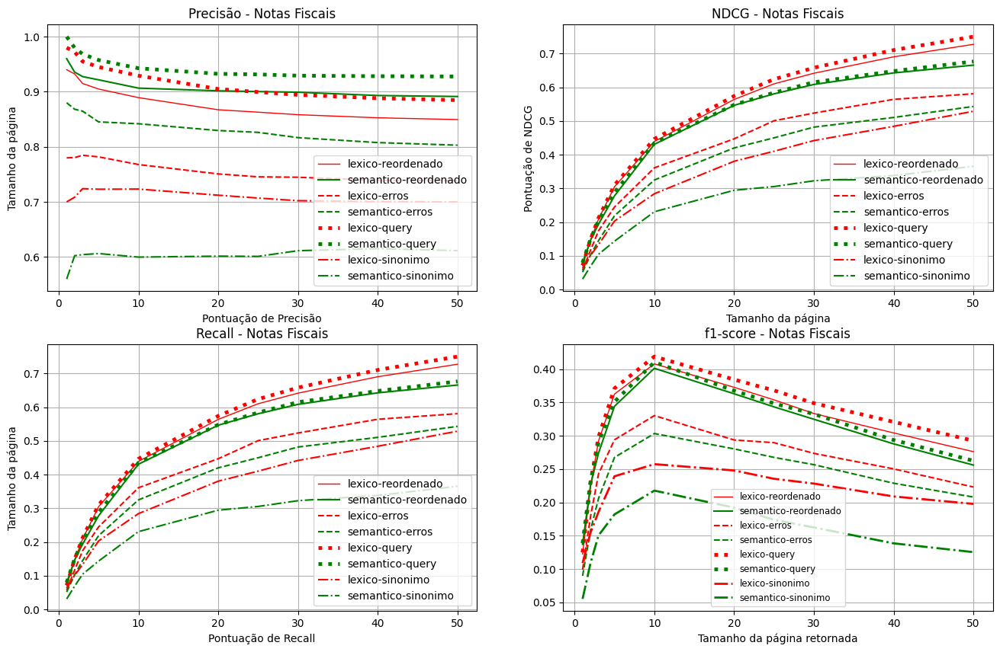

In [38]:
import matplotlib.pyplot as plt
import numpy as np
lexico = grouped_nf[grouped_nf['abordagem'] == 'lexico']   

semantico = grouped_nf[grouped_nf['abordagem'] == 'semantico']   
_, ax = plt.subplots(2, 2, figsize=(16,10)) 
ax[0,0].set_title('Precisão - Notas Fiscais')
ax[0,0].set_xlabel('Pontuação de Precisão')
ax[0,0].set_ylabel('Tamanho da página')
ax[0,0].plot(lexico['size_page'], lexico['ndcg_reordenados'], label='lexico-reordenado', color='red', linewidth=1.0, linestyle='-')
ax[0,0].plot(semantico['size_page'], semantico['ndcg_reordenados'], label='semantico-reordenado', color='green', linestyle='-'  )
ax[0,0].plot(lexico['size_page'], lexico['ndcg_erros_digitacao'], label='lexico-erros', color='red', linestyle='--')
ax[0,0].plot(semantico['size_page'], semantico['ndcg_erros_digitacao'], label='semantico-erros', color='green', linestyle='--'  )
ax[0,0].plot(lexico['size_page'], lexico['ndcg_query'], label='lexico-query', color='red', linewidth=3.5, linestyle=':')
ax[0,0].plot(semantico['size_page'], semantico['ndcg_query'], label='semantico-query', color='green', linewidth=3.5, linestyle=':')
ax[0,0].plot(lexico['size_page'], lexico['ndcg_sinonimos'], label='lexico-sinonimo', color='red', linestyle='-.')
ax[0,0].plot(semantico['size_page'], semantico['ndcg_sinonimos'], label='semantico-sinonimo', color='green', linestyle='-.')
ax[0,0].legend()
ax[0,0].grid('major')

ax[0,1].set_title('NDCG - Notas Fiscais')
ax[0,1].set_xlabel('Tamanho da página')
ax[0,1].set_ylabel('Pontuação de NDCG')
ax[0,1].plot(lexico['size_page'], lexico['recall_reordenados'], label='lexico-reordenado', color='red', linewidth=1.0, linestyle='-')
ax[0,1].plot(semantico['size_page'], semantico['recall_reordenados'], label='semantico-reordenado', color='green', linestyle='-'  )
ax[0,1].plot(lexico['size_page'], lexico['recall_erros_digitacao'], label='lexico-erros', color='red', linestyle='--')
ax[0,1].plot(semantico['size_page'], semantico['recall_erros_digitacao'], label='semantico-erros', color='green', linestyle='--'  )
ax[0,1].plot(lexico['size_page'], lexico['recall_query'], label='lexico-query', color='red', linewidth=3.5, linestyle=':')
ax[0,1].plot(semantico['size_page'], semantico['recall_query'], label='semantico-query', color='green', linewidth=3.5, linestyle=':')
ax[0,1].plot(lexico['size_page'], lexico['recall_sinonimos'], label='lexico-sinonimo', color='red', linestyle='-.')
ax[0,1].plot(semantico['size_page'], semantico['recall_sinonimos'], label='semantico-sinonimo', color='green', linestyle='-.')
ax[0,1].grid('major')
ax[0,1].legend()

ax[1,0].set_title('Recall - Notas Fiscais')
ax[1,0].set_xlabel('Tamanho da página')
ax[1,0].set_ylabel('Pontuação de NDCG')
ax[1,0].set_title('Recall - Notas Fiscais')
ax[1,0].set_xlabel('Pontuação de Recall')
ax[1,0].set_ylabel('Tamanho da página')
ax[1,0].plot(lexico['size_page'], lexico['recall_reordenados'], label='lexico-reordenado', color='red', linewidth=1.0, linestyle='-')
ax[1,0].plot(semantico['size_page'], semantico['recall_reordenados'], label='semantico-reordenado', color='green', linestyle='-'  )
ax[1,0].plot(lexico['size_page'], lexico['recall_erros_digitacao'], label='lexico-erros', color='red', linestyle='--')
ax[1,0].plot(semantico['size_page'], semantico['recall_erros_digitacao'], label='semantico-erros', color='green', linestyle='--'  )
ax[1,0].plot(lexico['size_page'], lexico['recall_query'], label='lexico-query', color='red', linewidth=3.5, linestyle=':')
ax[1,0].plot(semantico['size_page'], semantico['recall_query'], label='semantico-query', color='green', linewidth=3.5, linestyle=':')
ax[1,0].plot(lexico['size_page'], lexico['recall_sinonimos'], label='lexico-sinonimo', color='red', linestyle='-.')
ax[1,0].plot(semantico['size_page'], semantico['recall_sinonimos'], label='semantico-sinonimo', color='green', linestyle='-.')
ax[1,0].grid('major')
ax[1,0].legend()

ax[1,1].set_title('f1-score - Notas Fiscais')
ax[1,1].set_xlabel('Tamanho da página retornada')
ax[1,1].set_ylabel('')
ax[1,1].plot(lexico['size_page'], lexico['f1-score_reordenados'], label='lexico-reordenado', color='red', linewidth=1.0, linestyle='-')
ax[1,1].plot(semantico['size_page'], semantico['f1-score_reordenados'], label='semantico-reordenado', color='green', linestyle='-'  )
ax[1,1].plot(lexico['size_page'], lexico['f1-score_erros_digitacao'], label='lexico-erros', color='red', linestyle='--')
ax[1,1].plot(semantico['size_page'], semantico['f1-score_erros_digitacao'], label='semantico-erros', color='green', linestyle='--'  )
ax[1,1].plot(lexico['size_page'], lexico['f1-score_query'], label='lexico-query', color='red', linewidth=3.5, linestyle=':')
ax[1,1].plot(semantico['size_page'], semantico['f1-score_query'], label='semantico-query', color='green', linewidth=3.5, linestyle=':')
ax[1,1].plot(lexico['size_page'], lexico['f1-score_sinonimos'], label='lexico-sinonimo', color='red', linewidth=2, linestyle='-.')
ax[1,1].plot(semantico['size_page'], semantico['f1-score_sinonimos'], label='semantico-sinonimo', color='green', linewidth=2, linestyle='-.')
ax[1,1].grid('major')
ax[1,1].legend(fontsize=8.5)

In [50]:
result_10 = results.head(4)
result_10

,Unnamed: 0.1,Unnamed: 0,idx,query,page_size,abordagem,sinonimos,erros_digitacao,reordenados,result_query,result_sinonimos,result_erros_digitacao,result_reordenados
0,0,0,0,Estante De Livro Livreiro Plastico Modular Mul...,100,lexico,Livreiro Plástico com Prateleiras Modulares e ...,Estente De Livo Livreiro Plástico Modular Mult...,Livreiro Plastico Estante De Livro Modular Mul...,"{""took"":5,""timed_out"":false,""_shards"":{""total""...","{""took"":4,""timed_out"":false,""_shards"":{""total""...","{""took"":4,""timed_out"":false,""_shards"":{""total""...","{""took"":2,""timed_out"":false,""_shards"":{""total""..."
1,1,1,0,Estante De Livro Livreiro Plastico Modular Mul...,100,semantico,Livreiro Plástico com Prateleiras Modulares e ...,Estente De Livo Livreiro Plástico Modular Mult...,Livreiro Plastico Estante De Livro Modular Mul...,"{""took"":86,""timed_out"":false,""_shards"":{""total...","{""took"":82,""timed_out"":false,""_shards"":{""total...","{""took"":76,""timed_out"":false,""_shards"":{""total...","{""took"":88,""timed_out"":false,""_shards"":{""total..."
2,2,2,1,PALHA ATLAS DE ACO Na0,100,lexico,Fio de Aço Galvanizado Atlas para Aplicação em...,PALNA ATLAS DE AÇO Nao,PALHA Na0 ATLAS DE ACO,"{""took"":2,""timed_out"":false,""_shards"":{""total""...","{""took"":3,""timed_out"":false,""_shards"":{""total""...","{""took"":2,""timed_out"":false,""_shards"":{""total""...","{""took"":2,""timed_out"":false,""_shards"":{""total""..."
3,3,3,1,PALHA ATLAS DE ACO Na0,100,semantico,Fio de Aço Galvanizado Atlas para Aplicação em...,PALNA ATLAS DE AÇO Nao,PALHA Na0 ATLAS DE ACO,"{""took"":91,""timed_out"":false,""_shards"":{""total...","{""took"":113,""timed_out"":false,""_shards"":{""tota...","{""took"":102,""timed_out"":false,""_shards"":{""tota...","{""took"":95,""timed_out"":false,""_shards"":{""total..."


In [51]:
for i in ['query', 'sinonimos', 'erros_digitacao', 'reordenados']:
    result_query = 'result_' + i
    print(result_query)
    print(result_10[result_query])
    result_10[result_query] = result_10.apply(lambda row: json.loads(row[result_query]), axis=1)

result_query
0    {"took":5,"timed_out":false,"_shards":{"total"...
1    {"took":86,"timed_out":false,"_shards":{"total...
2    {"took":2,"timed_out":false,"_shards":{"total"...
3    {"took":91,"timed_out":false,"_shards":{"total...
Name: result_query, dtype: object
result_sinonimos
0    {"took":4,"timed_out":false,"_shards":{"total"...
1    {"took":82,"timed_out":false,"_shards":{"total...
2    {"took":3,"timed_out":false,"_shards":{"total"...
3    {"took":113,"timed_out":false,"_shards":{"tota...
Name: result_sinonimos, dtype: object
result_erros_digitacao
0    {"took":4,"timed_out":false,"_shards":{"total"...
1    {"took":76,"timed_out":false,"_shards":{"total...
2    {"took":2,"timed_out":false,"_shards":{"total"...
3    {"took":102,"timed_out":false,"_shards":{"tota...
Name: result_erros_digitacao, dtype: object
result_reordenados
0    {"took":2,"timed_out":false,"_shards":{"total"...
1    {"took":88,"timed_out":false,"_shards":{"total...
2    {"took":2,"timed_out":false,"_shards"

/tmp/ipykernel_72467/95219022.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  result_10[result_query] = result_10.apply(lambda row: json.loads(row[result_query]), axis=1)


In [57]:
import ast
import pandas as pd

ruidos = ['query', 'sinonimos', 'erros_digitacao', 'reordenados']
queries_df = pd.read_csv('dv_relev_sample.csv')
queries_df['relevantes'] = queries_df.apply(lambda row: ast.literal_eval(row['relevantes']), axis=1)

size_queries = [1, 2, 3, 5, 10, 20, 30, 40, 50, 100]

chunk_size = 1000 
chunks = [result_10[i:i+chunk_size] for i in range(0, len(result_10), chunk_size)]

df_geral = []

results_metricas = pd.DataFrame(columns=['abordagem', 'size_page'] + [f'{metrica}_{ruido}' for ruido in ruidos for metrica in ['precision', 'recall', 'f1-score', 'ndcg']])

for size_q in size_queries:
    for chunk in chunks:
        for idx, row in chunk.iterrows():
            result_metrics = {}
            result_metrics['size_page'] = size_q
            
            abord = row['abordagem']
            expected = queries_df.loc[row['idx'], 'relevantes']
            abordagem = row['abordagem']
            result_metrics['abordagem'] = abordagem
            
            for i in ruidos:
                result = row['result_' + i]
                items = result['hits']['hits'] if result else None
                conteudos = [objeto['_source'] for objeto in items] if items else []
                conteudos_slice = conteudos[:size_q]
                
                result_metrics[f'precision_{i}'] = precision(conteudos_slice, expected)
                result_metrics[f'recall_{i}'] = recall(conteudos_slice, expected, abordagem)
                result_metrics[f'f1-score_{i}'] = (2 * result_metrics[f'precision_{i}'] * result_metrics[f'recall_{i}']) / (result_metrics[f'precision_{i}'] + result_metrics[f'recall_{i}']) if (result_metrics[f'precision_{i}'] + result_metrics[f'recall_{i}']) > 0 else 0
                query_expected = queries_df.loc[row['idx'], 'DESCRICAO_PRODUTO']
                result_metrics[f'ndcg_{i}'] = ndcg(conteudos_slice, expected, query_expected)
            
            results_metricas.loc[idx] = result_metrics
    
    df_geral.append(results_metricas)

df_por_sizes = pd.concat(df_geral)


In [58]:
df_por_sizes

,abordagem,size_page,precision_query,recall_query,f1-score_query,ndcg_query,precision_sinonimos,recall_sinonimos,f1-score_sinonimos,ndcg_sinonimos,precision_erros_digitacao,recall_erros_digitacao,f1-score_erros_digitacao,ndcg_erros_digitacao,precision_reordenados,recall_reordenados,f1-score_reordenados,ndcg_reordenados
0,lexico,100,0.12,1.000000,0.214286,0.802983,0.12,1.00,0.214286,0.914274,0.06,0.500000,0.107143,0.868396,0.12,1.000000,0.214286,0.802983
1,semantico,100,0.05,0.416667,0.089286,0.821977,0.06,0.50,0.107143,0.942967,0.05,0.416667,0.089286,0.829487,0.05,0.416667,0.089286,0.820768
2,lexico,100,0.11,0.916667,0.196429,0.798135,0.09,0.75,0.160714,0.795900,0.06,0.500000,0.107143,0.468044,0.11,0.916667,0.196429,0.798135
3,semantico,100,0.11,0.916667,0.196429,0.899552,0.06,0.50,0.107143,0.792959,0.07,0.583333,0.125000,0.775833,0.10,0.833333,0.178571,0.905861
0,lexico,100,0.12,1.000000,0.214286,0.802983,0.12,1.00,0.214286,0.914274,0.06,0.500000,0.107143,0.868396,0.12,1.000000,0.214286,0.802983
1,semantico,100,0.05,0.416667,0.089286,0.821977,0.06,0.50,0.107143,0.942967,0.05,0.416667,0.089286,0.829487,0.05,0.416667,0.089286,0.820768
2,lexico,100,0.11,0.916667,0.196429,0.798135,0.09,0.75,0.160714,0.795900,0.06,0.500000,0.107143,0.468044,0.11,0.916667,0.196429,0.798135
3,semantico,100,0.11,0.916667,0.196429,0.899552,0.06,0.50,0.107143,0.792959,0.07,0.583333,0.125000,0.775833,0.10,0.833333,0.178571,0.905861
0,lexico,100,0.12,1.000000,0.214286,0.802983,0.12,1.00,0.214286,0.914274,0.06,0.500000,0.107143,0.868396,0.12,1.000000,0.214286,0.802983
1,semantico,100,0.05,0.416667,0.089286,0.821977,0.06,0.50,0.107143,0.942967,0.05,0.416667,0.089286,0.829487,0.05,0.416667,0.089286,0.820768


In [61]:
import ast
import pandas as pd

ruidos = ['query', 'sinonimos', 'erros_digitacao', 'reordenados']
queries_df = pd.read_csv('dv_relev_sample.csv')
queries_df['relevantes'] = queries_df.apply(lambda row: ast.literal_eval(row['relevantes']), axis=1)

df_geral = []

# Dividir os dados de results em lotes de 10 linhas
chunk_size = 10
chunks = [result_10[i:i+chunk_size] for i in range(0, len(result_10), chunk_size)]

for chunk in chunks:
    chunk_results_metricas = []
    
    for size_q in size_queries:
        results_metricas = pd.DataFrame(columns=['abordagem', 'size_page'] + [f'{metrica}_{ruido}' for ruido in ruidos for metrica in ['precision', 'recall', 'f1-score', 'ndcg']])
        
        for idx, row in chunk.iterrows():
            result_metrics = {}
            result_metrics['size_page'] = size_q
            
            abord = row['abordagem']
            expected = queries_df.loc[row['idx'], 'relevantes']
            abordagem = row['abordagem']
            result_metrics['abordagem'] = abordagem
            
            for i in ruidos:
                result = row['result_' + i]
                items = result['hits']['hits'] if result else None
                conteudos = [objeto['_source'] for objeto in items] if items else []
                conteudos_slice = conteudos[:size_q]
                
                result_metrics[f'precision_{i}'] = precision(conteudos_slice, expected)
                result_metrics[f'recall_{i}'] = recall(conteudos_slice, expected, abordagem)
                result_metrics[f'f1-score_{i}'] = (2 * result_metrics[f'precision_{i}'] * result_metrics[f'recall_{i}']) / (result_metrics[f'precision_{i}'] + result_metrics[f'recall_{i}']) if (result_metrics[f'precision_{i}'] + result_metrics[f'recall_{i}']) > 0 else 0
                query_expected = queries_df.loc[row['idx'], 'DESCRICAO_PRODUTO']
                result_metrics[f'ndcg_{i}'] = ndcg(conteudos_slice, expected, query_expected)
            
            chunk_results_metricas.append(result_metrics)
    
    chunk_results_df = pd.DataFrame(chunk_results_metricas)
    
    df_geral.append(chunk_results_df)

df_por_sizes = pd.concat(df_geral)


In [63]:
df_por_sizes

,size_page,abordagem,precision_query,recall_query,f1-score_query,ndcg_query,precision_sinonimos,recall_sinonimos,f1-score_sinonimos,ndcg_sinonimos,precision_erros_digitacao,recall_erros_digitacao,f1-score_erros_digitacao,ndcg_erros_digitacao,precision_reordenados,recall_reordenados,f1-score_reordenados,ndcg_reordenados
0,1,lexico,1.000000,0.083333,0.153846,1.000000,1.000000,0.083333,0.153846,1.000000,1.000000,0.083333,0.153846,1.000000,1.000000,0.083333,0.153846,1.000000
1,1,semantico,1.000000,0.083333,0.153846,1.000000,1.000000,0.083333,0.153846,1.000000,1.000000,0.083333,0.153846,1.000000,1.000000,0.083333,0.153846,1.000000
2,1,lexico,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000
3,1,semantico,1.000000,0.083333,0.153846,1.000000,1.000000,0.083333,0.153846,1.000000,0.000000,0.000000,0.000000,1.000000,1.000000,0.083333,0.153846,1.000000
4,2,lexico,1.000000,0.166667,0.285714,1.000000,1.000000,0.166667,0.285714,1.000000,1.000000,0.166667,0.285714,1.000000,1.000000,0.166667,0.285714,1.000000
5,2,semantico,0.500000,0.083333,0.142857,1.000000,1.000000,0.166667,0.285714,1.000000,0.500000,0.083333,0.142857,1.000000,0.500000,0.083333,0.142857,1.000000
6,2,lexico,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000
7,2,semantico,1.000000,0.166667,0.285714,1.000000,0.500000,0.083333,0.142857,1.000000,0.500000,0.083333,0.142857,0.796708,1.000000,0.166667,0.285714,1.000000
8,3,lexico,0.666667,0.166667,0.266667,1.000000,1.000000,0.250000,0.400000,1.000000,0.666667,0.166667,0.266667,1.000000,0.666667,0.166667,0.266667,1.000000
9,3,semantico,0.333333,0.083333,0.133333,1.000000,1.000000,0.250000,0.400000,1.000000,0.333333,0.083333,0.133333,0.963940,0.333333,0.083333,0.133333,1.000000


# Metricas por tamanho da page

In [22]:
grouped = df_por_sizes.groupby(['size_page', 'abordagem'], as_index=False).agg({'ndcg_query': 'mean', 'precision_query': 'mean', 'f1-score_query': 'mean', 'recall_query': 'mean'})
grouped

,size_page,abordagem,ndcg_query,precision_query,f1-score_query,recall_query


In [28]:
grouped = df_por_sizes.groupby(['size_page', 'abordagem'], as_index=False).agg({'ndcg_erros_digitacao': 'mean', 'precision_erros_digitacao': 'mean', 'f1-score_erros_digitacao': 'mean', 'recall_erros_digitacao': 'mean'})
grouped

,size_page,abordagem,ndcg_erros_digitacao,precision_erros_digitacao,f1-score_erros_digitacao,recall_erros_digitacao
0,1,lexico,0.5,0.5,0.100047,0.057457
1,1,semantico,0.42,0.42,0.076648,0.043945
2,2,lexico,0.575712,0.51,0.184542,0.119697
3,2,semantico,0.520949,0.45,0.140029,0.088855
4,3,lexico,0.605895,0.5,0.242882,0.174048
5,3,semantico,0.575948,0.446667,0.18832,0.131503
6,5,lexico,0.618025,0.448,0.293265,0.243891
7,5,semantico,0.605099,0.44,0.264677,0.216432
8,10,lexico,0.636763,0.358,0.331205,0.362449
9,10,semantico,0.625493,0.348,0.304262,0.329441


In [29]:
grouped = df_por_sizes.groupby(['size_page', 'abordagem'], as_index=False).agg({'ndcg_reordenados': 'mean', 'precision_reordenados': 'mean', 'f1-score_reordenados': 'mean', 'recall_reordenados': 'mean'})
grouped

,size_page,abordagem,ndcg_reordenados,precision_reordenados,f1-score_reordenados,recall_reordenados
0,1,lexico,0.64,0.64,0.122324,0.070083
1,1,semantico,0.66,0.66,0.123882,0.07074
2,2,lexico,0.703093,0.61,0.210813,0.136042
3,2,semantico,0.74833,0.64,0.209484,0.132901
4,3,lexico,0.747565,0.613333,0.294375,0.210893
5,3,semantico,0.757263,0.593333,0.262318,0.183018
6,5,lexico,0.740572,0.552,0.364418,0.305849
7,5,semantico,0.759575,0.568,0.345222,0.279195
8,10,lexico,0.749718,0.456,0.413395,0.447168
9,10,semantico,0.748876,0.468,0.413257,0.441898


In [30]:
grouped = df_por_sizes.groupby(['size_page', 'abordagem'], as_index=False).agg({'ndcg_sinonimos': 'mean', 'precision_sinonimos': 'mean', 'f1-score_sinonimos': 'mean', 'recall_sinonimos': 'mean'})
grouped

,size_page,abordagem,ndcg_sinonimos,precision_sinonimos,f1-score_sinonimos,recall_sinonimos
0,1,lexico,0.52,0.52,0.107089,0.062021
1,1,semantico,0.5,0.5,0.094258,0.053647
2,2,lexico,0.583093,0.48,0.168423,0.108734
3,2,semantico,0.537856,0.45,0.14771,0.094124
4,3,lexico,0.616487,0.446667,0.205799,0.145021
5,3,semantico,0.545539,0.426667,0.184629,0.127715
6,5,lexico,0.627817,0.396,0.251034,0.20371
7,5,semantico,0.576392,0.404,0.250877,0.202902
8,10,lexico,0.644482,0.328,0.297661,0.318347
9,10,semantico,0.601605,0.316,0.291836,0.314712


Resultados query page 100

In [141]:
results_metricas.groupby(['abordagem']).agg(
    {'ndcg_query': ['mean', 'std'], 'precision_query': ['mean', 'std'], 'f1-score_query': ['mean', 'std'], 'recall_query': ['mean', 'std']})


ndcg_query           precision_query           f1-score_query  \
                mean       std            mean       std           mean   
abordagem                                                                 
lexico      0.764697  0.229569          0.1112  0.092992       0.185446   
semantico   0.729384  0.263190          0.1012  0.089662       0.168316   

                    recall_query            
                std         mean       std  
abordagem                                   
lexico     0.131726      0.81549  0.257105  
semantico  0.127428     0.746621  0.311091

In [47]:
results_metricas.groupby(['abordagem']).agg(
    {'ndcg_sinonimos': ['mean', 'std'], 'precision_sinonimos': ['mean', 'std'], 'f1-score_sinonimos': ['mean', 'std'], 'recall_sinonimos': ['mean', 'std'],
     })

ndcg_sinonimos           precision_sinonimos            \
                    mean       std                mean       std   
abordagem                                                          
lexico          0.614008  0.289079               0.088  0.082065   
semantico       0.543356  0.357254              0.0574  0.048141   

          f1-score_sinonimos           recall_sinonimos            
                        mean       std             mean       std  
abordagem                                                          
lexico              0.147909  0.120232         0.673124  0.331910  
semantico           0.099222  0.079947         0.493788  0.369884

In [49]:
results_metricas.groupby(['abordagem']).agg({'ndcg_erros_digitacao': ['mean', 'std'], 'precision_erros_digitacao': ['mean', 'std'], 'f1-score_erros_digitacao': ['mean', 'std'], 'recall_erros_digitacao': ['mean', 'std']})

ndcg_erros_digitacao           precision_erros_digitacao            \
                          mean       std                      mean       std   
abordagem                                                                      
lexico                0.632503  0.344374                    0.0832  0.092349   
semantico             0.616028  0.298584                    0.0824  0.088607   

          f1-score_erros_digitacao           recall_erros_digitacao            
                              mean       std                   mean       std  
abordagem                                                                      
lexico                    0.138774  0.134192               0.618408  0.383122  
semantico                 0.137147  0.126242                0.62656  0.337369

In [50]:
results_metricas.groupby(['abordagem']).agg(
    {'ndcg_reordenados': ['mean', 'std'], 'precision_reordenados': ['mean', 'std'], 'f1-score_reordenados': ['mean', 'std'], 'recall_reordenados': ['mean', 'std']})

ndcg_reordenados           precision_reordenados            \
                      mean       std                  mean       std   
abordagem                                                              
lexico            0.733826  0.273510                0.1026  0.092930   
semantico          0.72063  0.292392                0.0966  0.091509   

          f1-score_reordenados           recall_reordenados            
                          mean       std               mean       std  
abordagem                                                              
lexico                0.172475  0.133263            0.78739  0.300081  
semantico               0.1614  0.130949           0.736071  0.325094

In [219]:

processed = 0
size = len(results)
teste_2 = pd.DataFrame()
for idx, row in results.iterrows():
    for i in ruidos:
        results_ruidos = row['result_' + i]
        items = results_ruidos['hits']['hits']
        conteudos = [objeto['_source'] for objeto in items]
        processed += 1
        if processed % 100 == 0:
            print(f'{processed} de {size} ({(processed/size)*100:.2f}%)')
        
        query_expected = queries_df.loc[row['idx'], 'DESCRICAO_PRODUTO']
        expected = queries_df.loc[row['idx'], 'relevantes']
        annoted_results = []
        for result in conteudos:
            r_copy = copy.deepcopy(result)
            filtered = list(filter(lambda x: x[0] == result['id'], expected))
            r_copy['relevance'] = filtered[0][1] if len(filtered) > 0 else 1 if is_similar(result['descricao_produto'], query_expected) else 0
            annoted_results.append(r_copy)
        teste_2['result_' + i] = annoted_results
teste_2    

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

100 de 100 (100.00%)


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

200 de 100 (200.00%)


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

300 de 100 (300.00%)


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

400 de 100 (400.00%)


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

,result_query,result_sinonimos,result_erros_digitacao,result_reordenados
0,"{'id': 46375347, 'numero_nota_fiscal': 311, 'c...","{'id': 73870043, 'numero_nota_fiscal': 4657, '...","{'id': 40846152, 'numero_nota_fiscal': 126, 'c...","{'id': 40846152, 'numero_nota_fiscal': 126, 'c..."
1,"{'id': 40846152, 'numero_nota_fiscal': 126, 'c...","{'id': 34985889, 'numero_nota_fiscal': 7590, '...","{'id': 46375347, 'numero_nota_fiscal': 311, 'c...","{'id': 46375347, 'numero_nota_fiscal': 311, 'c..."
2,"{'id': 72530828, 'numero_nota_fiscal': 829, 'c...","{'id': 57373124, 'numero_nota_fiscal': 820, 'c...","{'id': 72530828, 'numero_nota_fiscal': 829, 'c...","{'id': 72530828, 'numero_nota_fiscal': 829, 'c..."
3,"{'id': 17192740, 'numero_nota_fiscal': 2444, '...","{'id': 35385536, 'numero_nota_fiscal': 3593, '...","{'id': 17192740, 'numero_nota_fiscal': 2444, '...","{'id': 17192740, 'numero_nota_fiscal': 2444, '..."
4,"{'id': 45184958, 'numero_nota_fiscal': 20507, ...","{'id': 40131383, 'numero_nota_fiscal': 103236,...","{'id': 35155862, 'numero_nota_fiscal': 517, 'c...","{'id': 45184958, 'numero_nota_fiscal': 20507, ..."


In [ ]:
results_100 = results[results['page_size'] == 100]

processed = 0
size = len(results_100)
for idx, row in results_100.iterrows():
    processed += 1
    if processed % 100 == 0:
        print(f'{processed} de {size} ({(processed/size)*100:.2f}%)')
    items = result['hits']['hits']
    conteudos = [objeto['_source'] for objeto in items]
            
    expected = queries_df.loc[row['idx'], 'relevantes']
    annoted_results = []
    for result in conteudos:
        r_copy = copy.deepcopy(result)
        filtered = list(filter(lambda x: x[0] == result['id'], expected))
        r_copy['relevance'] = filtered[0][1] if len(filtered) > 0 else 1 if is_similar(result['descricao'], query) else 0
        annoted_results.append(r_copy)
    row['result'] = annoted_results